In [30]:
!git clone https://github.com/kelvis24/simple-3d-objects.git

!pip install torch

!pip install plyfile

!pip install matplotlib

fatal: destination path 'simple-3d-objects' already exists and is not an empty directory.


In [31]:
# Import necessary libraries
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from plyfile import PlyData
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from torch.optim import Adam
from sklearn.decomposition import PCA
from torch.optim import Adam
device="cuda"

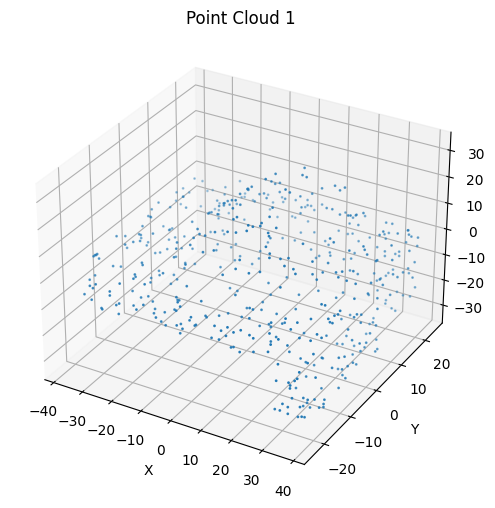

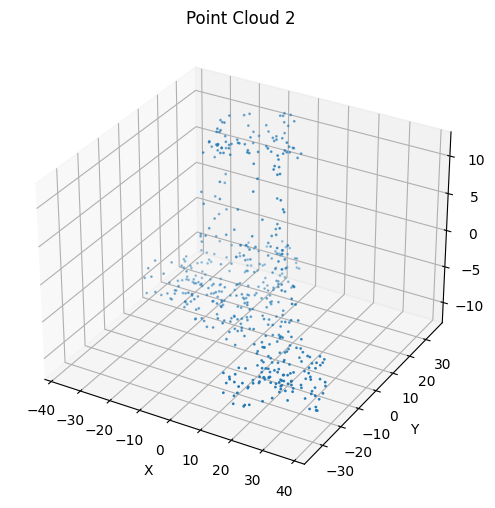

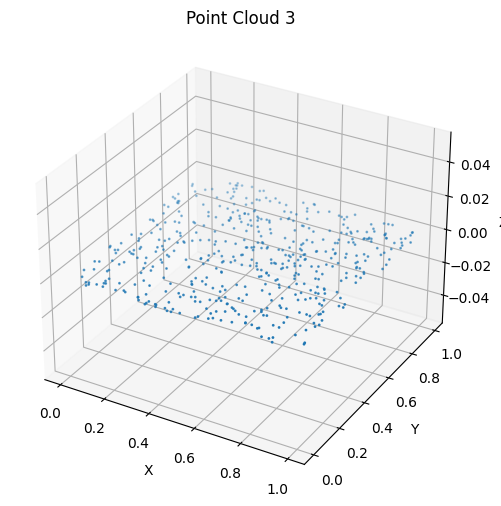

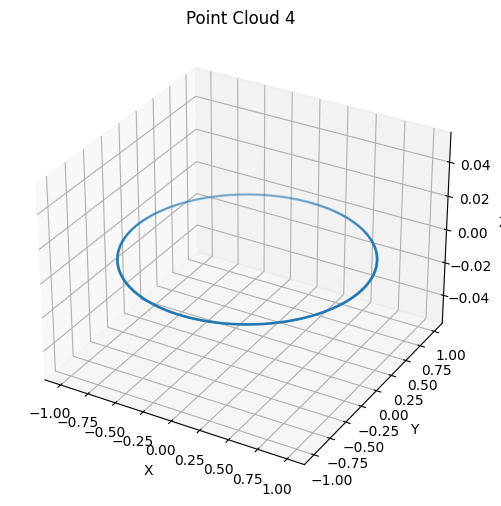

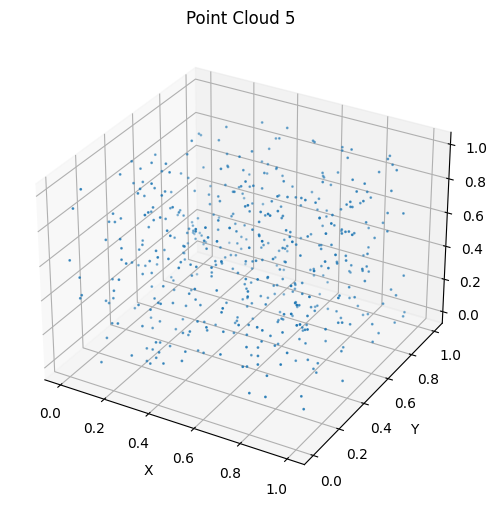

...

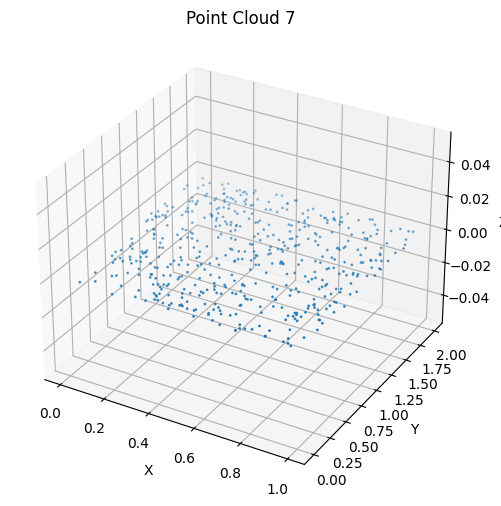

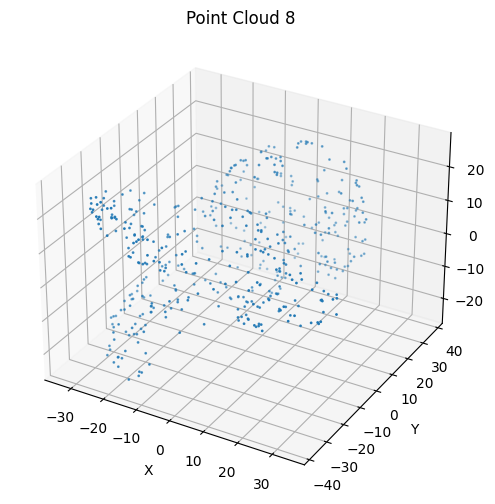

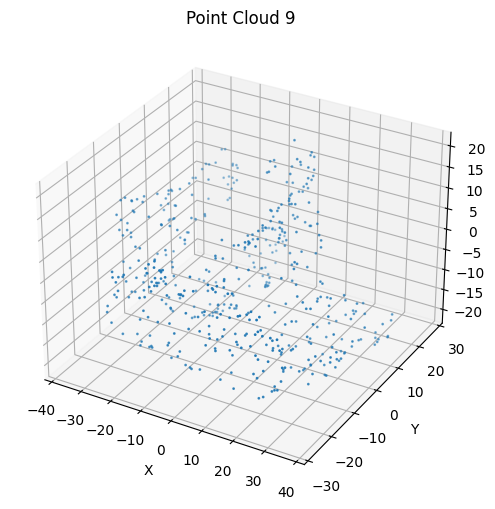

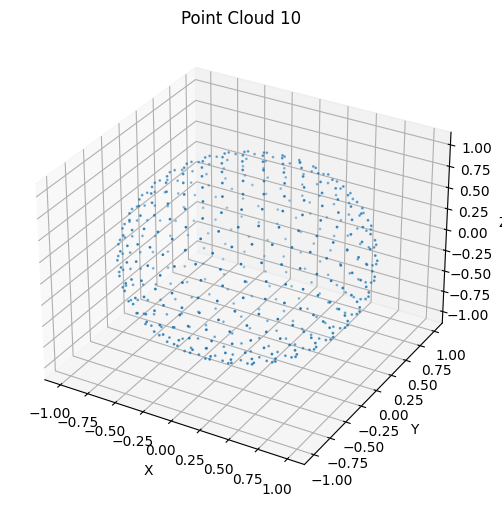

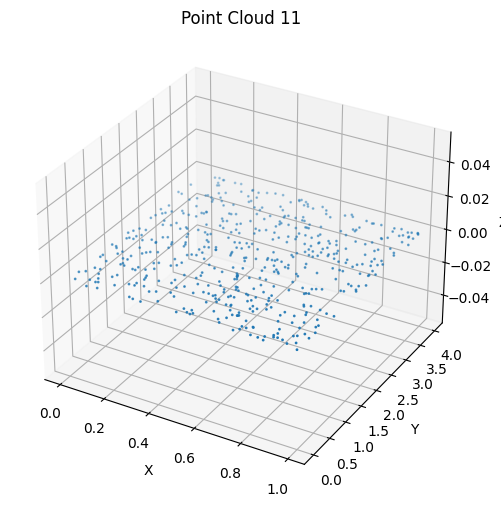

In [32]:
class PointCloudProcessor:
    def __init__(self, point_clouds_directory):
        self.point_clouds_directory = point_clouds_directory
        self.point_clouds = self.load_and_preprocess_point_clouds()

    def load_point_cloud_from_ply(self, file_path):
        ply_data = PlyData.read(file_path)
        points = np.column_stack((ply_data['vertex']['x'], ply_data['vertex']['y'], ply_data['vertex']['z']))
        return torch.tensor(points, dtype=torch.float)

    def resample_point_cloud(self, point_cloud, num_points):
        if len(point_cloud) == num_points:
            return point_cloud
        elif len(point_cloud) > num_points:
            indices = np.random.choice(len(point_cloud), size=num_points, replace=False)
            return point_cloud[indices]
        else:
            raise ValueError("Point cloud has fewer points than required for resampling.")

    def plot_point_cloud(self, points, title="Point Cloud", ax=None):
        if ax is None:
            fig = plt.figure(figsize=(8, 6))
            ax = fig.add_subplot(111, projection='3d')
        ax.scatter(points[:, 0], points[:, 1], points[:, 2], s=1)  # 's' is the size of each point
        ax.set_title(title)
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        plt.show()

    def visualize_reconstruction(self, original, reconstructed, title1="Original", title2="Reconstructed"):
        fig = plt.figure(figsize=(12, 6))

        ax1 = fig.add_subplot(121, projection='3d')
        ax1.scatter(original[:, 0], original[:, 1], original[:, 2], s=1)
        ax1.title.set_text(title1)
        ax1.set_xlabel('X')
        ax1.set_ylabel('Y')
        ax1.set_zlabel('Z')

        ax2 = fig.add_subplot(122, projection='3d')
        ax2.scatter(reconstructed[:, 0], reconstructed[:, 1], reconstructed[:, 2], s=1)
        ax2.title.set_text(title2)
        ax2.set_xlabel('X')
        ax2.set_ylabel('Y')
        ax2.set_zlabel('Z')

        plt.show()

    def load_and_preprocess_point_clouds(self):
        point_cloud_files = [f for f in os.listdir(self.point_clouds_directory) if f.endswith('.ply')]
        point_clouds = [self.load_point_cloud_from_ply(os.path.join(self.point_clouds_directory, f)) for f in point_cloud_files]

        # Resample all point clouds to have the same number of points
        self.min_points = min(pc.shape[0] for pc in point_clouds)
        return [self.resample_point_cloud(pc, self.min_points) for pc in point_clouds]

# Example usage:
point_clouds_directory = './simple-3d-objects'
processor = PointCloudProcessor(point_clouds_directory)

for i, point_cloud in enumerate(processor.point_clouds):
    processor.plot_point_cloud(point_cloud, title=f"Point Cloud {i + 1}")


In [33]:
min_points = processor.min_points # or set to 500
print(min_points)

500


In [34]:
# PointNet Encoder
class PointNetEncoder(nn.Module):
    def __init__(self, output_size=128):
        super(PointNetEncoder, self).__init__()
        self.conv1 = nn.Conv1d(3, 64, 1)
        self.conv2 = nn.Conv1d(64, 128, 1)
        self.conv3 = nn.Conv1d(128, output_size, 1)

    def forward(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = self.conv3(x)
        x = torch.max(x, 2, keepdim=False)[0]
        return x

# PointNet Decoder
class PointNetDecoder(nn.Module):
    def __init__(self, num_points=2048, latent_size=128):
        super(PointNetDecoder, self).__init__()
        self.num_points = num_points
        self.fc1 = nn.Linear(latent_size, 512)
        self.fc2 = nn.Linear(512, 256)
        self.fc3 = nn.Linear(256, num_points * 3)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x.view(-1, self.num_points, 3)

# PointNet Autoencoder
class PointNetAutoencoder(nn.Module):
    def __init__(self, num_points=min_points, latent_size=128):
        super(PointNetAutoencoder, self).__init__()
        self.encoder = PointNetEncoder(output_size=latent_size)
        self.decoder = PointNetDecoder(num_points=num_points, latent_size=latent_size)

    def forward(self, x):
        x = x.transpose(1, 2)  # PointNet expects [batch, channels, points]
        latent = self.encoder(x)
        reconstructed = self.decoder(latent)
        return reconstructed, latent

In [155]:
import torch
import torch.nn as nn
from torch.optim import Adam
import matplotlib.pyplot as plt

class Train:
    def __init__(self):
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    def train_and_visualize_on_single_point_cloud(self, point_cloud, epochs=100, lr=0.001, visualize_every_n_epochs=20, condition=False):
            autoencoder = PointNetAutoencoder().to(device)
            optimizer = Adam(autoencoder.parameters(), lr=lr)
            criterion = nn.MSELoss()

            point_cloud_tensor = point_cloud.unsqueeze(0).to( self.device)  # Ensure it's in the correct shape for training

            for epoch in range(epochs):
                # Forward pass
                reconstructed, _ = autoencoder(point_cloud_tensor)
                loss = criterion(reconstructed, point_cloud_tensor)

                # Backward pass and optimize
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()

                if (epoch + 1) % visualize_every_n_epochs == 0 or epoch == epochs - 1:
                    print(f"Epoch {epoch + 1}, Loss: {loss.item()}")
                    with torch.no_grad():
                        reconstructed, _ = autoencoder(point_cloud_tensor)
                        self.visualize_reconstruction(point_cloud_tensor.squeeze().cpu().numpy(),
                                                reconstructed.squeeze().cpu().numpy(),
                                                "Original", "Reconstructed", condition)

            return autoencoder


    def train_and_visualize_on_multiple_point_clouds(self, point_clouds, num_points=500, latent_size=218, epochs=100, lr=0.001, visualize_every_n_epochs=20, condition=False):
            criterion = nn.MSELoss()

            for pc_index, point_cloud in enumerate(point_clouds):
                autoencoder = PointNetAutoencoder(num_points, latent_size).to( self.device)
                optimizer = Adam(autoencoder.parameters(), lr=lr)
                point_cloud_tensor = point_cloud.unsqueeze(0).to( self.device)  # Add batch dimension

                print(f"Training Point Cloud {pc_index + 1}/{len(point_clouds)}")

                for epoch in range(epochs):
                    # Forward pass
                    reconstructed, _ = autoencoder(point_cloud_tensor)
                    loss = criterion(reconstructed, point_cloud_tensor)

                    # Backward pass and optimize
                    optimizer.zero_grad()
                    loss.backward()
                    optimizer.step()

                    if (epoch + 1) % visualize_every_n_epochs == 0 or epoch == epochs - 1:
                        print(f"Epoch {epoch + 1}, Loss: {loss.item()}")
                        with torch.no_grad():
                            reconstructed, _ = autoencoder(point_cloud_tensor)
                            self.visualize_reconstruction(point_cloud_tensor.squeeze().cpu().numpy(),
                                                    reconstructed.squeeze().cpu().numpy(),
                                                    "Original", "Reconstructed", condition)

            return autoencoder


    def train_and_visualize_using_different_autoencoders_on_multiple_pointclouds(self, autoencoder, point_clouds, epochs=100, lr=0.001, visualize_every_n_epochs=20, condition=False):
            criterion = nn.MSELoss()
            optimizer = Adam(autoencoder.parameters(), lr=lr)

            for pc_index, point_cloud in enumerate(point_clouds):
                point_cloud_tensor = point_cloud.unsqueeze(0).to( self.device)  # Add batch dimension

                print(f"Training Point Cloud {pc_index + 1}/{len(point_clouds)} with Autoencoder")

                for epoch in range(epochs):
                    # Forward pass
                    reconstructed, _ = autoencoder(point_cloud_tensor)
                    loss = criterion(reconstructed, point_cloud_tensor)

                    # Backward pass and optimize
                    optimizer.zero_grad()
                    loss.backward()
                    optimizer.step()

                    if (epoch + 1) % visualize_every_n_epochs == 0 or epoch == epochs - 1:
                        print(f"Epoch {epoch + 1}, Loss: {loss.item()}")
                        with torch.no_grad():
                            reconstructed, _ = autoencoder(point_cloud_tensor)
                            self.visualize_reconstruction(point_cloud_tensor.squeeze().cpu().numpy(),
                                                    reconstructed.squeeze().cpu().numpy(),
                                                    "Original", "Reconstructed", condition)

            return autoencoder


    def train_and_visualize_using_different_autoencoders_on_single_pointcloud(self, autoencoder, point_cloud, epochs=100, lr=0.001, visualize_every_n_epochs=20, condition=False):
            autoencoder.to( self.device)
            criterion = nn.MSELoss()
            optimizer = Adam(autoencoder.parameters(), lr=lr)

            # Ensure point_cloud is on the correct device
            point_cloud = point_cloud.to( self.device).unsqueeze(0)  # Ensure there is a batch dimension

            for epoch in range(epochs):
                # Forward pass
                reconstructed, _ = autoencoder(point_cloud)
                loss = criterion(reconstructed, point_cloud)

                # Backward pass and optimize
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()

                # Visualization and logging
                if (epoch + 1) % visualize_every_n_epochs == 0 or (epoch + 1) == epochs:
                    print(f"Epoch {epoch+1}, Loss: {loss.item()}")
                    with torch.no_grad():
                        original = point_cloud.squeeze().cpu().numpy()  # Use the point cloud for visualization
                        reconstructed, _ = autoencoder(point_cloud)
                        reconstructed = reconstructed.squeeze().cpu().numpy()
                        self.visualize_reconstruction(original, reconstructed, "Original", "Reconstructed", condition)
            return autoencoder


    def train_and_return_losses(self, autoencoder, point_cloud, epochs=100, lr=0.001):
        optimizer = Adam(autoencoder.parameters(), lr=lr)
        criterion = nn.MSELoss()
        losses = []

        point_cloud = point_cloud.to(self.device).unsqueeze(0)

        for epoch in range(epochs):
            autoencoder.train()
            optimizer.zero_grad()
            reconstructed, _ = autoencoder(point_cloud)
            loss = criterion(reconstructed, point_cloud)
            loss.backward()
            optimizer.step()

            losses.append(loss.item())

        return losses

    def plot_loss_convergence_for_latent_sizes(self, latent_sizes, min_points, point_clouds, point_cloud_index, epochs=100, lr=0.001):
        loss_records = {}

        for latent_size in latent_sizes:
            print(f"Training with latent size: {latent_size}")
            # Assuming the autoencoder model can be re-initialized with different latent sizes
            autoencoder = PointNetAutoencoder(num_points=min_points, latent_size=latent_size).to(device)

            losses = self.train_and_return_losses(autoencoder, point_clouds[point_cloud_index] , epochs, lr)
            loss_records[latent_size] = losses

        plt.figure(figsize=(10, 7))
        for latent_size, losses in loss_records.items():
            plt.plot(losses, label=f'Latent Size {latent_size}')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Loss Convergence for Different Latent Sizes')
        plt.legend()
        plt.show()

    def encode_point_cloud(self, autoencoder, point_cloud):
         # Reshape selected_point_cloud to [1, 3, num_points] for the model
        if point_cloud.dim() == 2 and point_cloud.size(1) == 3:
            model_input = point_cloud.transpose(0, 1).unsqueeze(0)
        else:
            print("Unexpected point cloud shape. Ensure it's [num_points, 3].")

        with torch.no_grad():
            autoencoder.eval()
            point_cloud = point_cloud.to(self.device).unsqueeze(0)
            _, latent_representation = autoencoder(point_cloud)
            return latent_representation.squeeze().cpu().numpy()

    def print_encode_point_cloud(self, point_cloud):
         print(self.encode_point_cloud(autoencoder, point_cloud))

    def visualize_reconstruction(self, original, reconstructed, title1="Original", title2="Reconstructed", condition=True):
        if condition:
            fig = plt.figure(figsize=(12, 6))

            ax1 = fig.add_subplot(121, projection='3d')
            ax1.scatter(original[:, 0], original[:, 1], original[:, 2], s=1)
            ax1.title.set_text(title1)
            ax1.set_xlabel('X')
            ax1.set_ylabel('Y')
            ax1.set_zlabel('Z')

            ax2 = fig.add_subplot(122, projection='3d')
            ax2.scatter(reconstructed[:, 0], reconstructed[:, 1], reconstructed[:, 2], s=1)
            ax2.title.set_text(title2)
            ax2.set_xlabel('X')
            ax2.set_ylabel('Y')
            ax2.set_zlabel('Z')

            plt.show()
        else:
          pass


In [156]:
trainer = Train()

Epoch 10, Loss: 0.08459934592247009


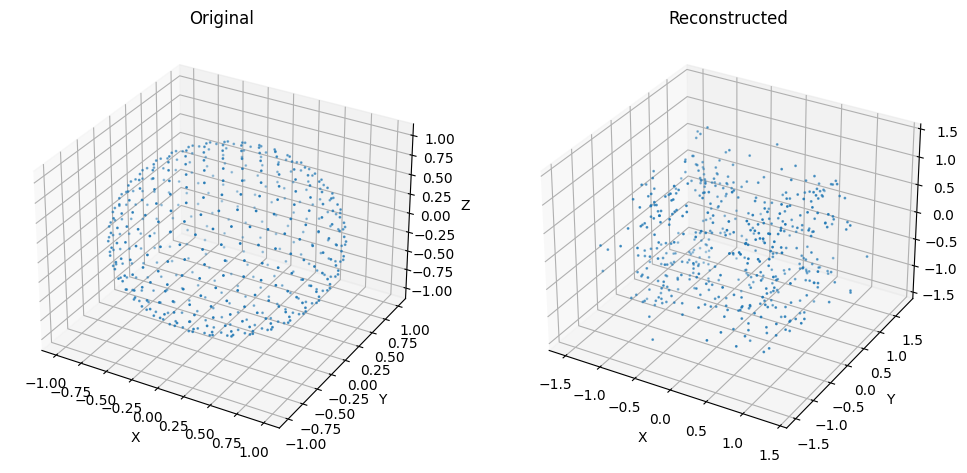

Epoch 20, Loss: 0.012060057371854782


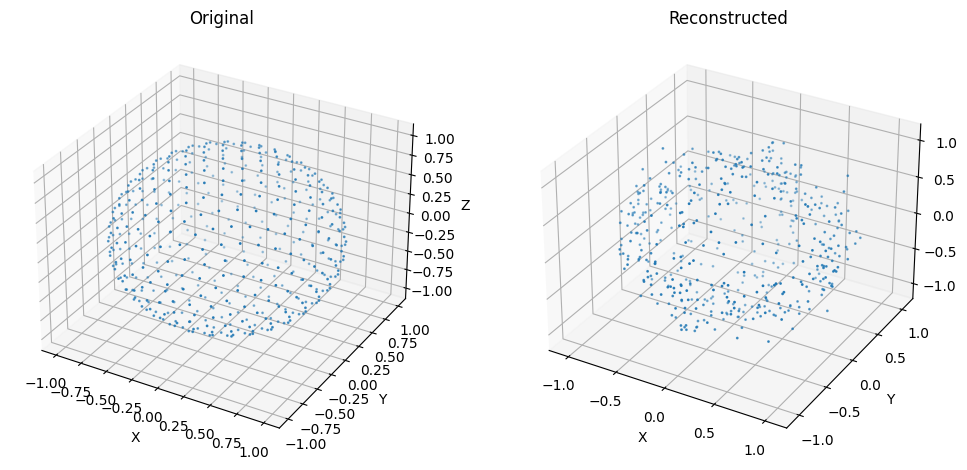

Epoch 30, Loss: 0.005806043744087219


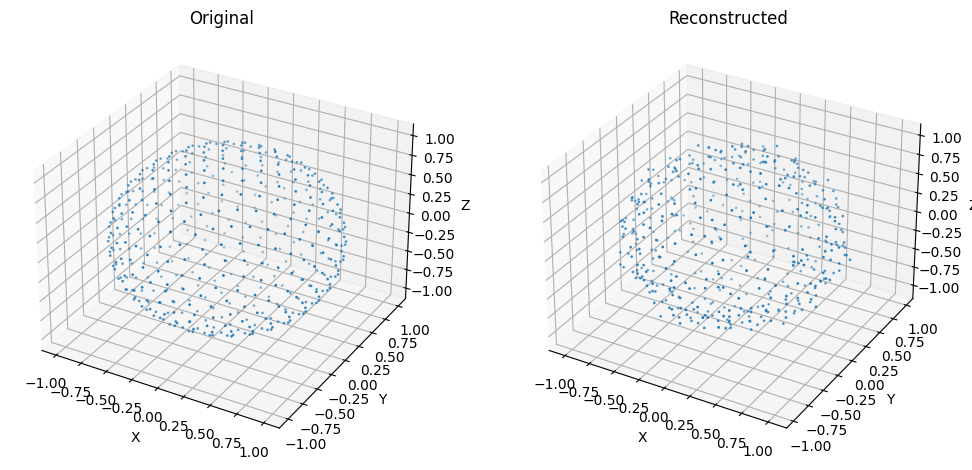

Epoch 40, Loss: 0.0011456540087237954


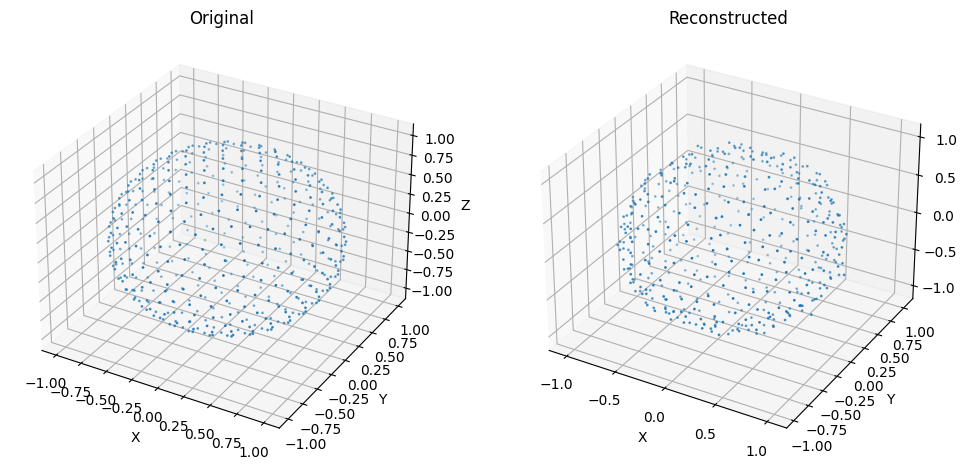

Epoch 50, Loss: 0.0005217589205130935


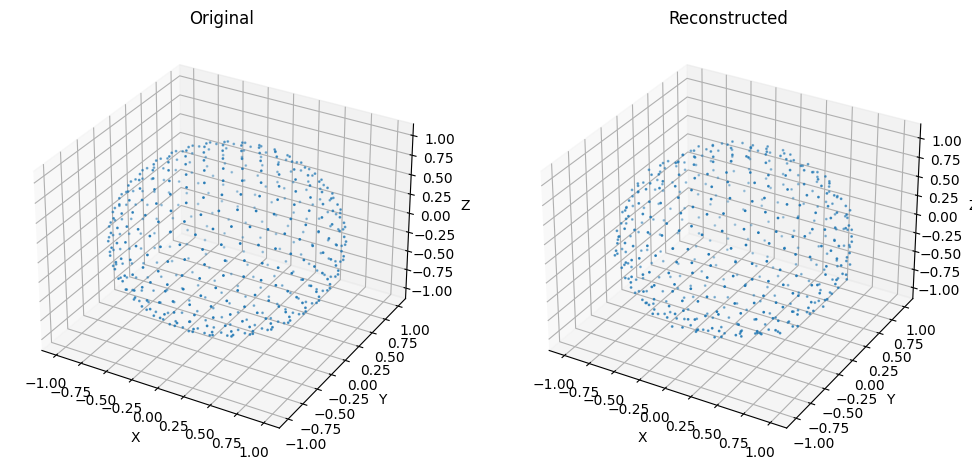

PointNetAutoencoder(
  (encoder): PointNetEncoder(
    (conv1): Conv1d(3, 64, kernel_size=(1,), stride=(1,))
    (conv2): Conv1d(64, 128, kernel_size=(1,), stride=(1,))
    (conv3): Conv1d(128, 128, kernel_size=(1,), stride=(1,))
  )
  (decoder): PointNetDecoder(
    (fc1): Linear(in_features=128, out_features=512, bias=True)
    (fc2): Linear(in_features=512, out_features=256, bias=True)
    (fc3): Linear(in_features=256, out_features=1500, bias=True)
  )
)

In [158]:
trainer.train_and_visualize_on_single_point_cloud(processor.point_clouds[9], epochs=50, lr=0.001, visualize_every_n_epochs=10, condition=True)

Training Point Cloud 1/11
Epoch 10, Loss: 100.26485443115234


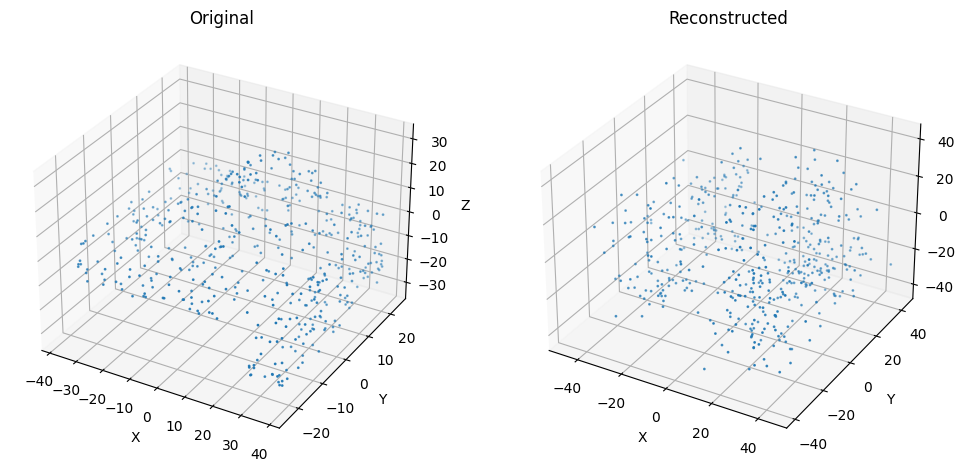

Training Point Cloud 2/11
Epoch 10, Loss: 79.41964721679688


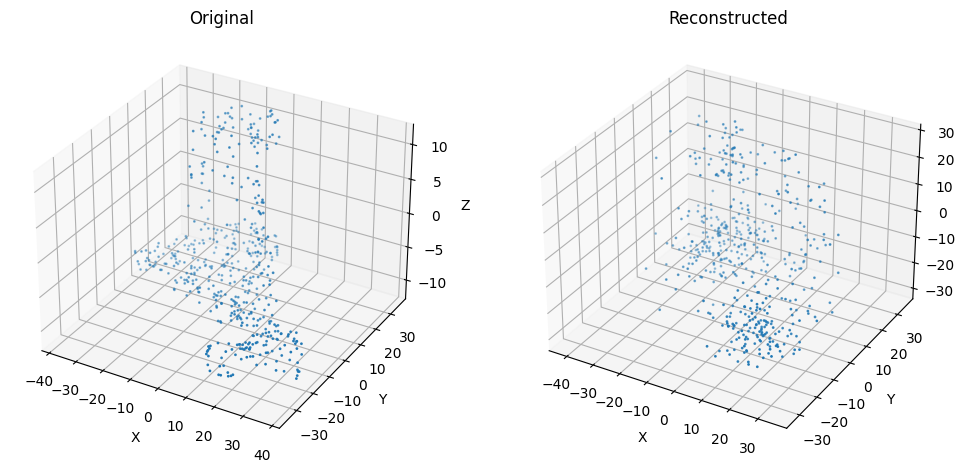

Training Point Cloud 3/11
Epoch 10, Loss: 0.054157357662916183


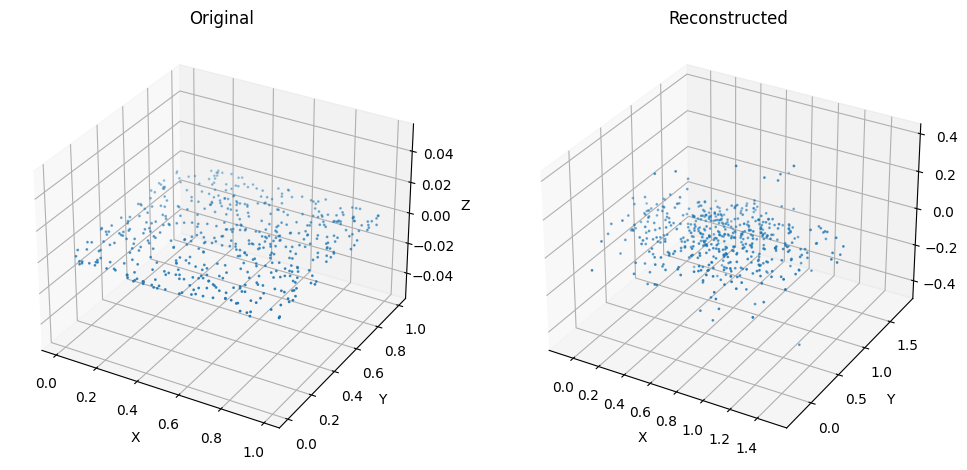

Training Point Cloud 4/11
Epoch 10, Loss: 0.07341231405735016


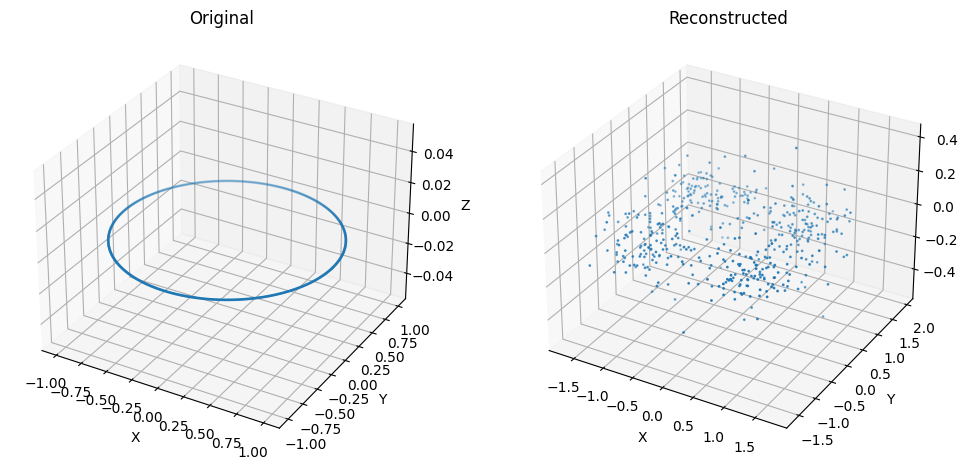

Training Point Cloud 5/11
Epoch 10, Loss: 0.10868214815855026


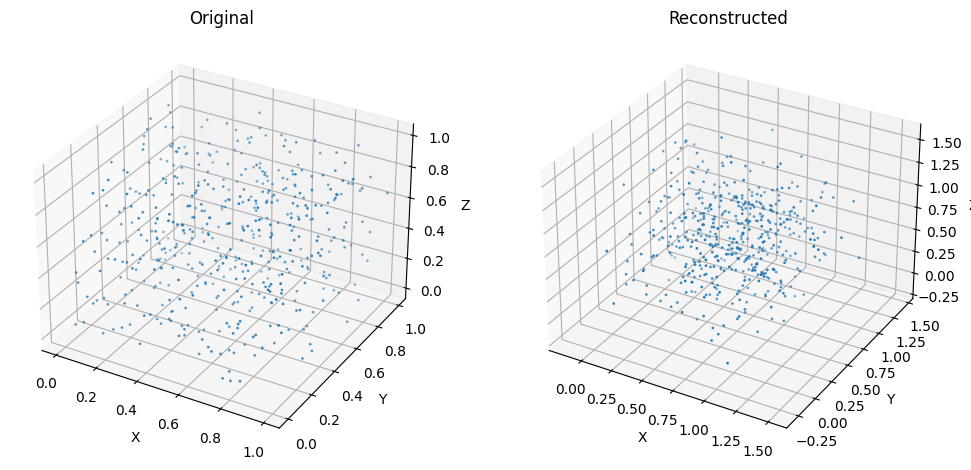

Training Point Cloud 6/11
Epoch 10, Loss: 73.89850616455078


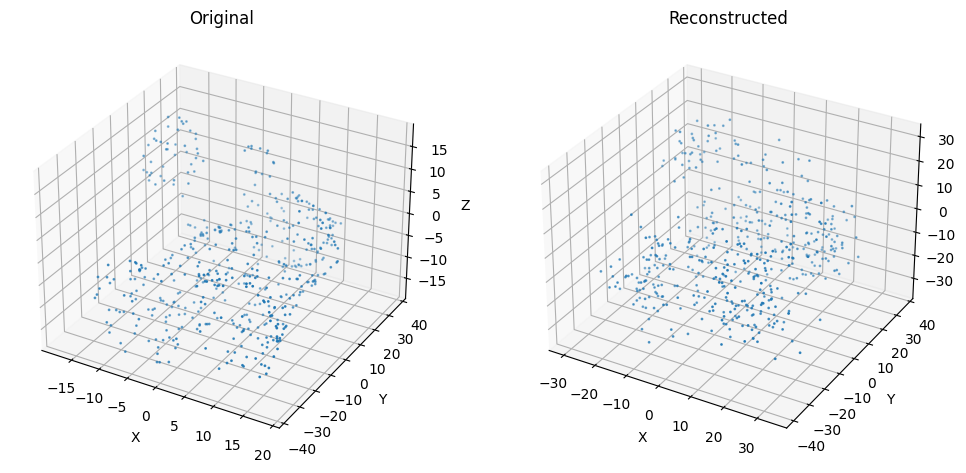

Training Point Cloud 7/11
Epoch 10, Loss: 0.1827886551618576


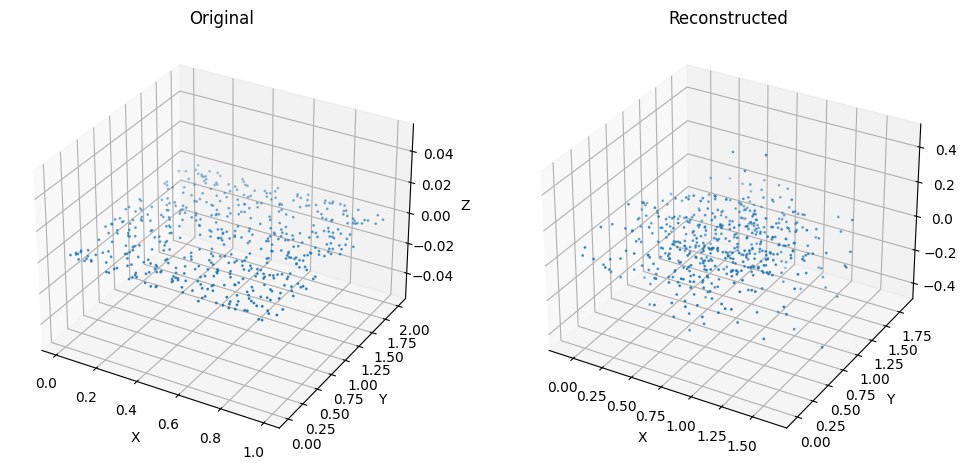

Training Point Cloud 8/11
Epoch 10, Loss: 89.57384490966797


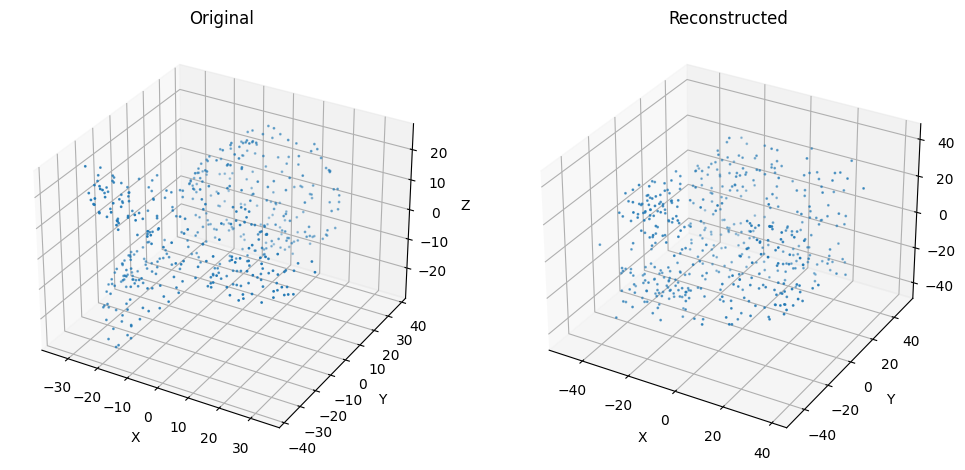

Training Point Cloud 9/11
Epoch 10, Loss: 81.77305603027344


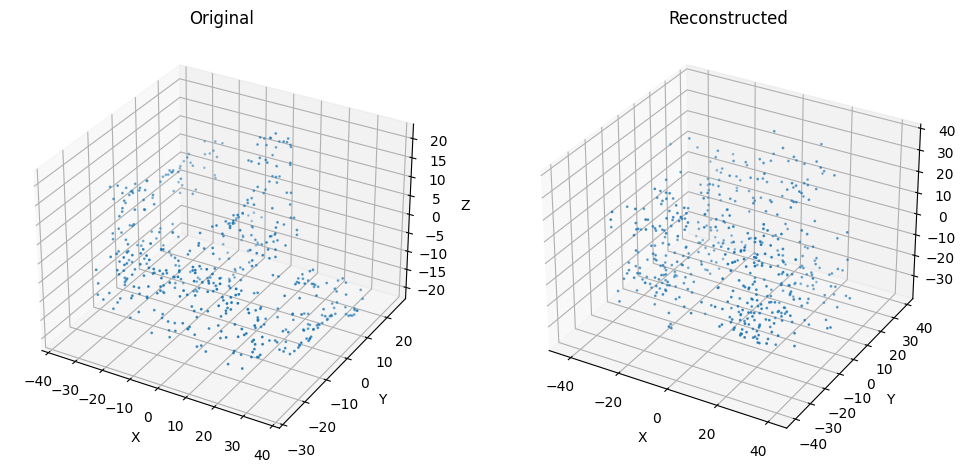

Training Point Cloud 10/11
Epoch 10, Loss: 0.09937100857496262


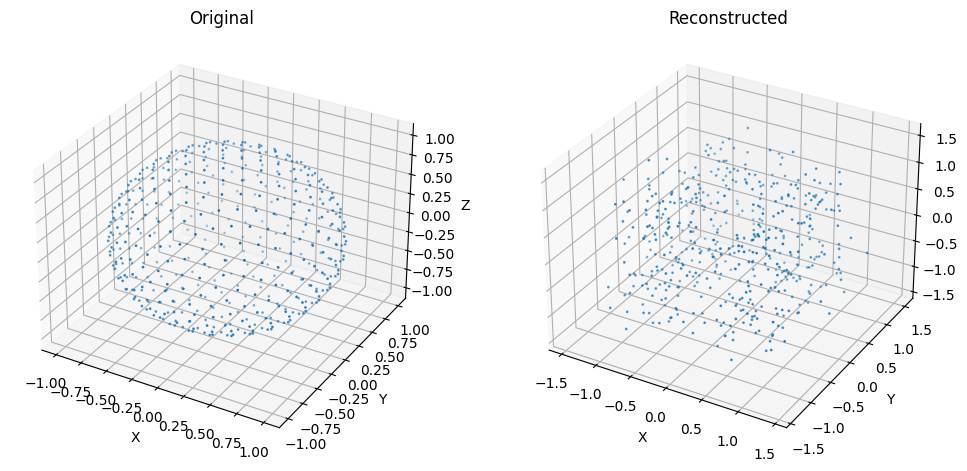

Training Point Cloud 11/11
Epoch 10, Loss: 0.7099939584732056


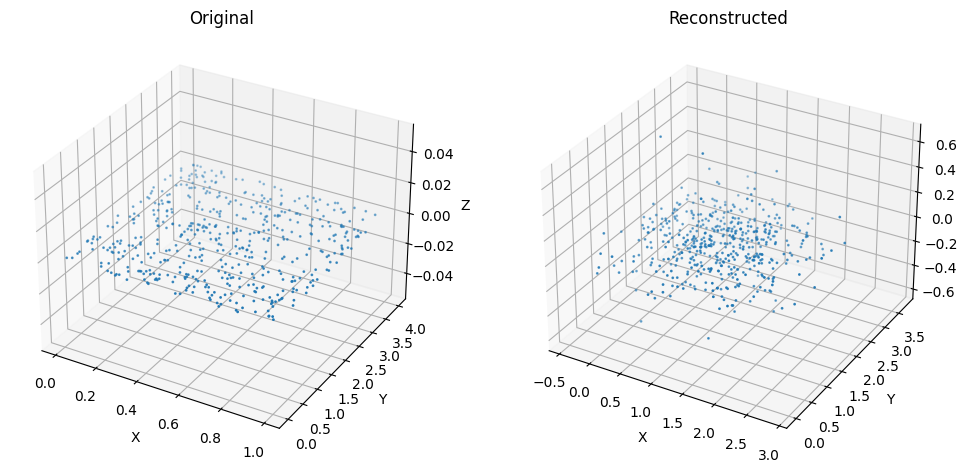

PointNetAutoencoder(
  (encoder): PointNetEncoder(
    (conv1): Conv1d(3, 64, kernel_size=(1,), stride=(1,))
    (conv2): Conv1d(64, 128, kernel_size=(1,), stride=(1,))
    (conv3): Conv1d(128, 218, kernel_size=(1,), stride=(1,))
  )
  (decoder): PointNetDecoder(
    (fc1): Linear(in_features=218, out_features=512, bias=True)
    (fc2): Linear(in_features=512, out_features=256, bias=True)
    (fc3): Linear(in_features=256, out_features=1500, bias=True)
  )
)

In [159]:
trainer.train_and_visualize_on_multiple_point_clouds(processor.point_clouds, epochs=10, lr=0.001, visualize_every_n_epochs=10, condition=True)

Training with latent size: 64





Training Point Cloud 1/11 with Autoencoder
Epoch 10, Loss: 127.2623291015625


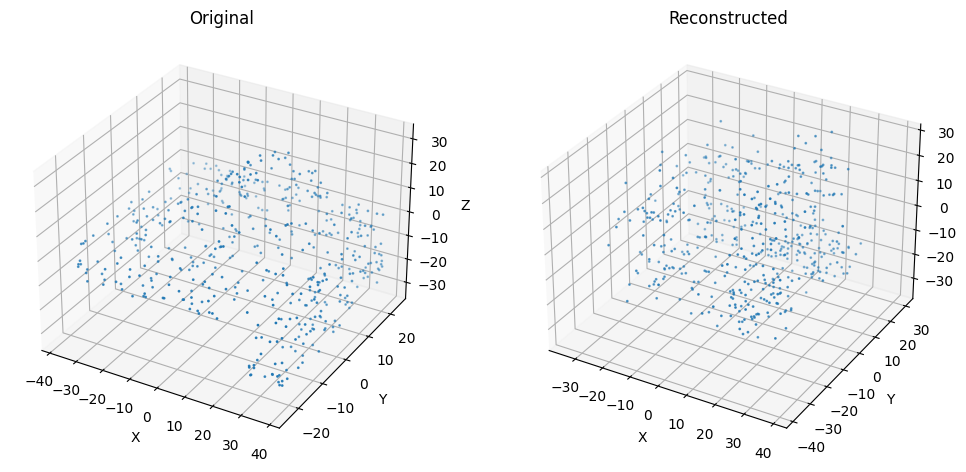

Training Point Cloud 2/11 with Autoencoder
Epoch 10, Loss: 190.04708862304688


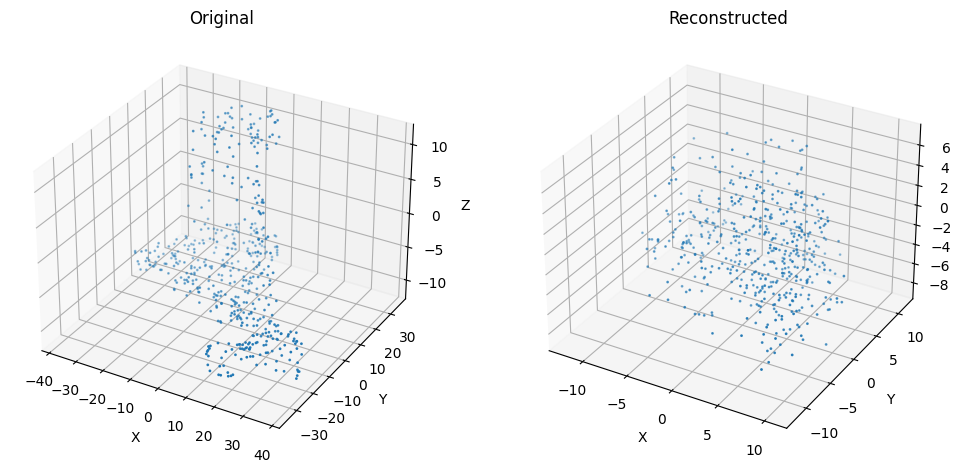

Training Point Cloud 3/11 with Autoencoder
Epoch 10, Loss: 0.19404228031635284


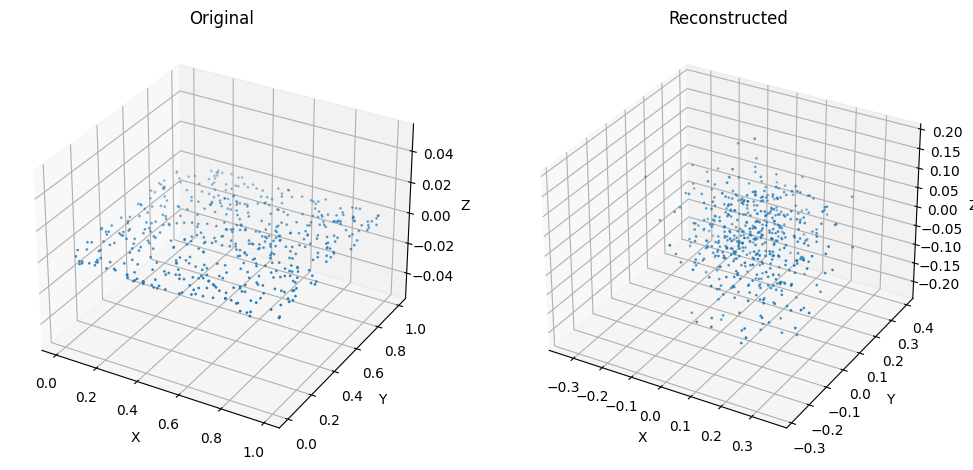

Training Point Cloud 4/11 with Autoencoder
Epoch 10, Loss: 0.27574700117111206


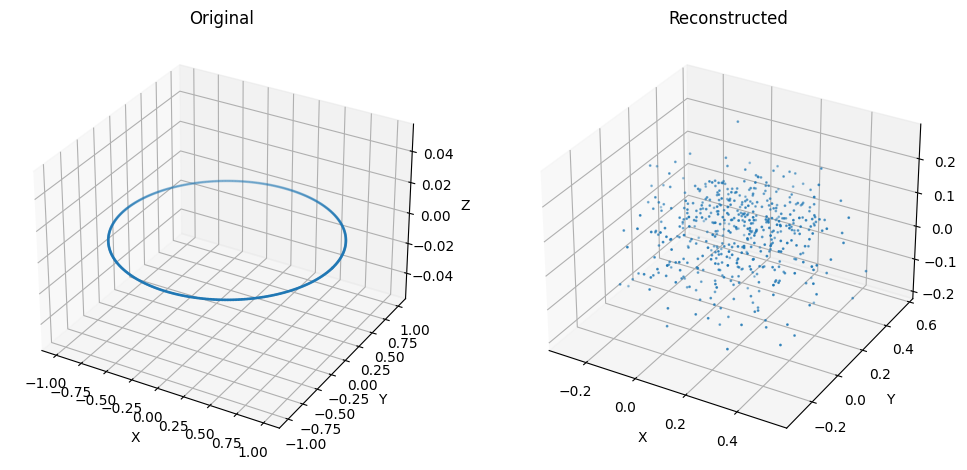

Training Point Cloud 5/11 with Autoencoder
Epoch 10, Loss: 0.16295446455478668


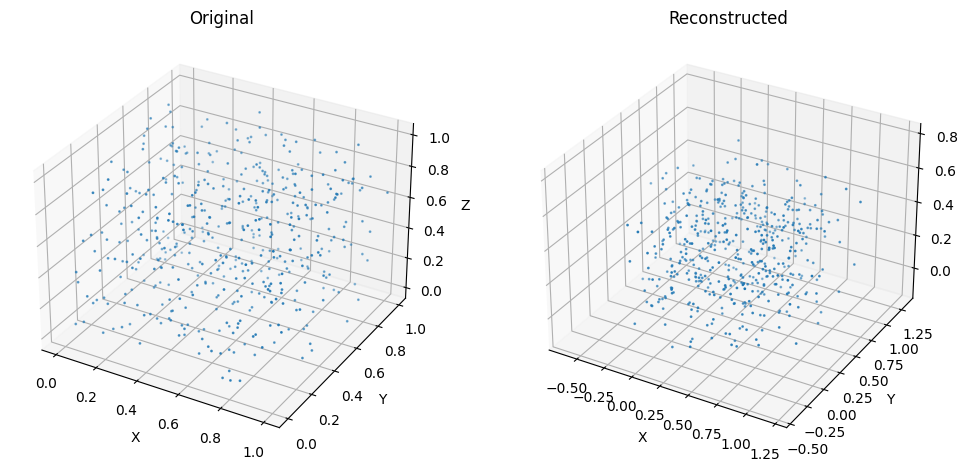

Training Point Cloud 6/11 with Autoencoder
Epoch 10, Loss: 194.39889526367188


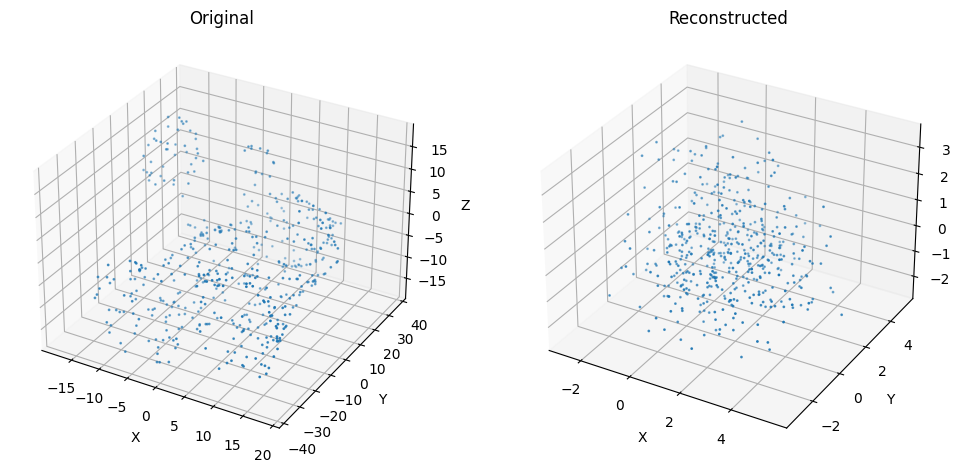

Training Point Cloud 7/11 with Autoencoder
Epoch 10, Loss: 0.4543086588382721


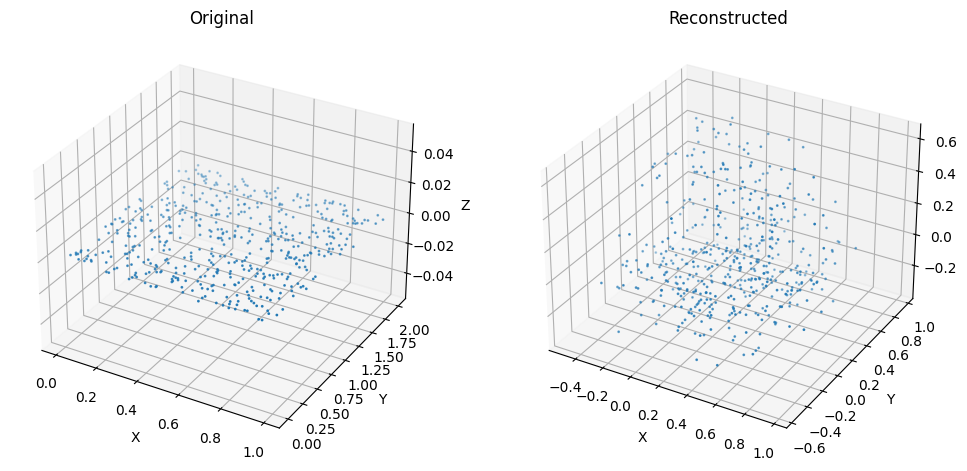

Training Point Cloud 8/11 with Autoencoder
Epoch 10, Loss: 286.9426574707031


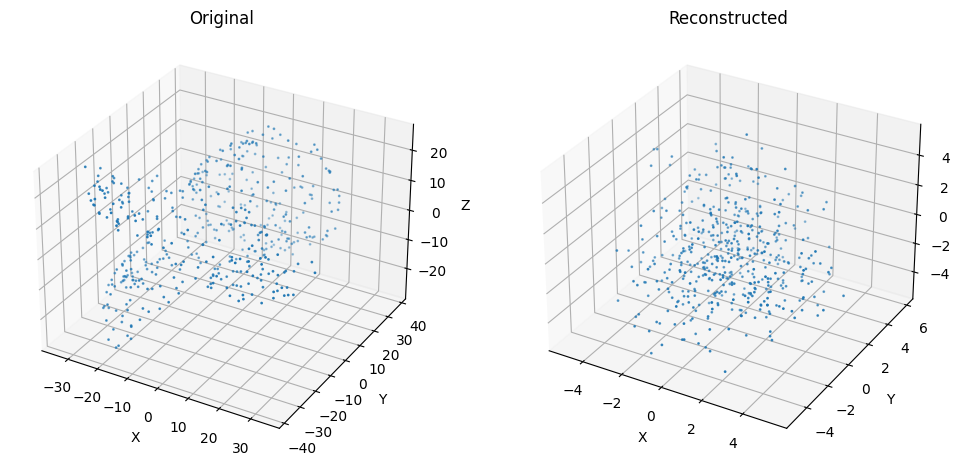

Training Point Cloud 9/11 with Autoencoder
Epoch 10, Loss: 234.4998321533203


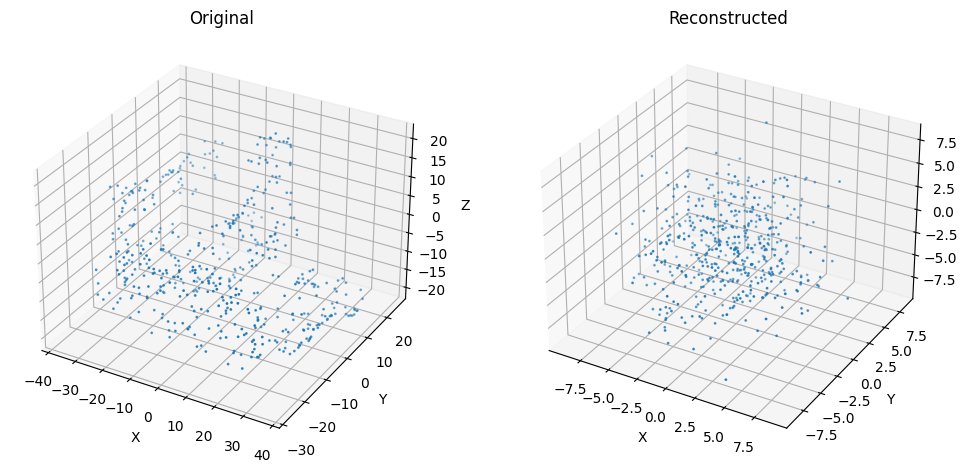

Training Point Cloud 10/11 with Autoencoder
Epoch 10, Loss: 0.37990617752075195


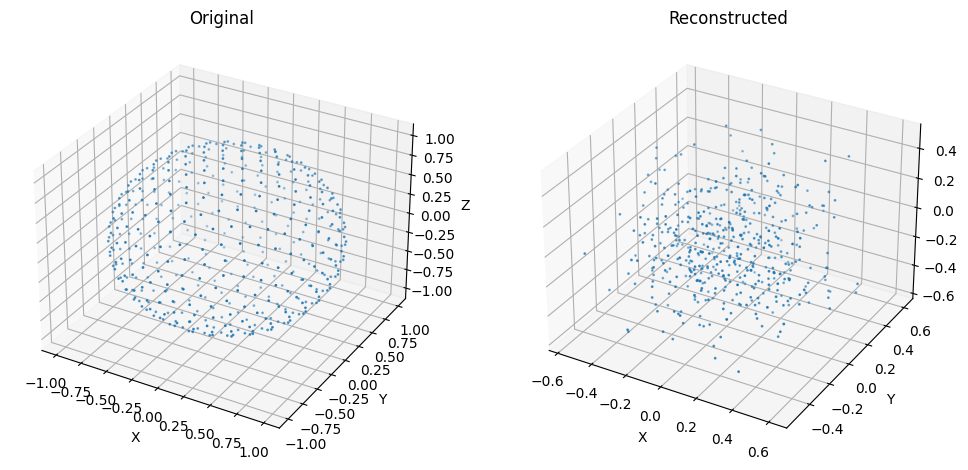

Training Point Cloud 11/11 with Autoencoder
Epoch 10, Loss: 1.6585439443588257


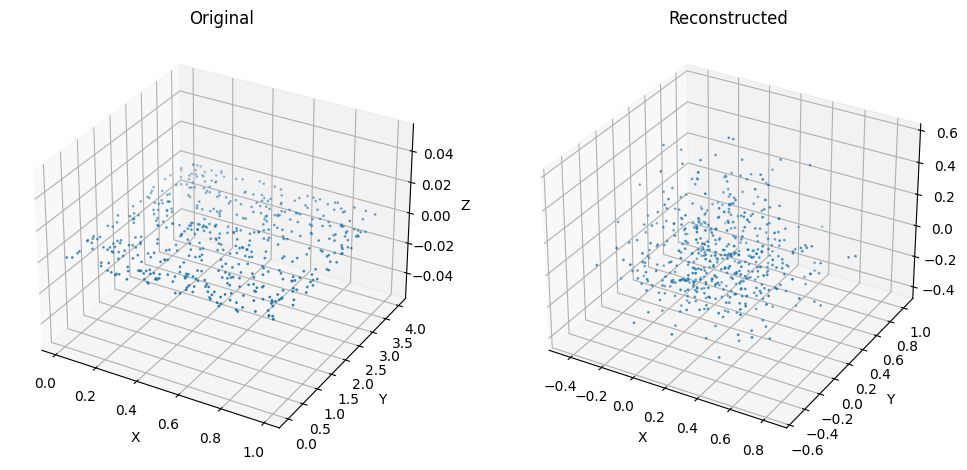

Training with latent size: 128





Training Point Cloud 1/11 with Autoencoder
Epoch 10, Loss: 110.93243408203125


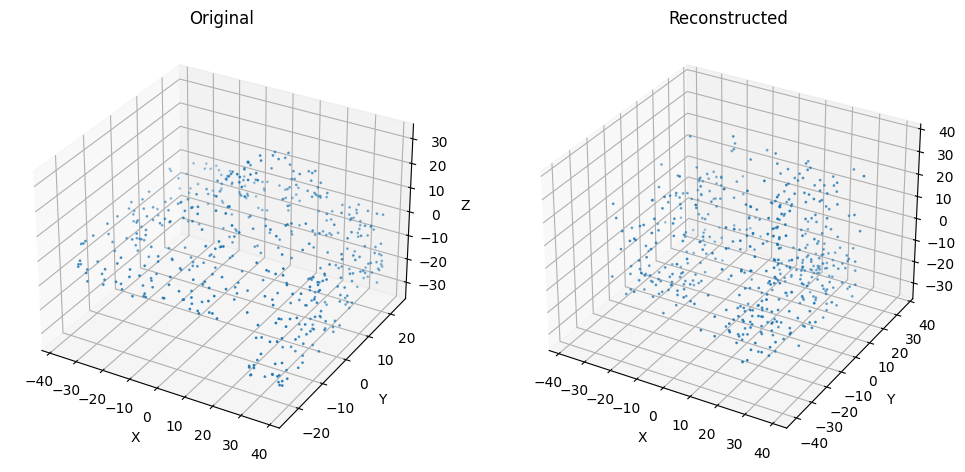

Training Point Cloud 2/11 with Autoencoder
Epoch 10, Loss: 196.776123046875


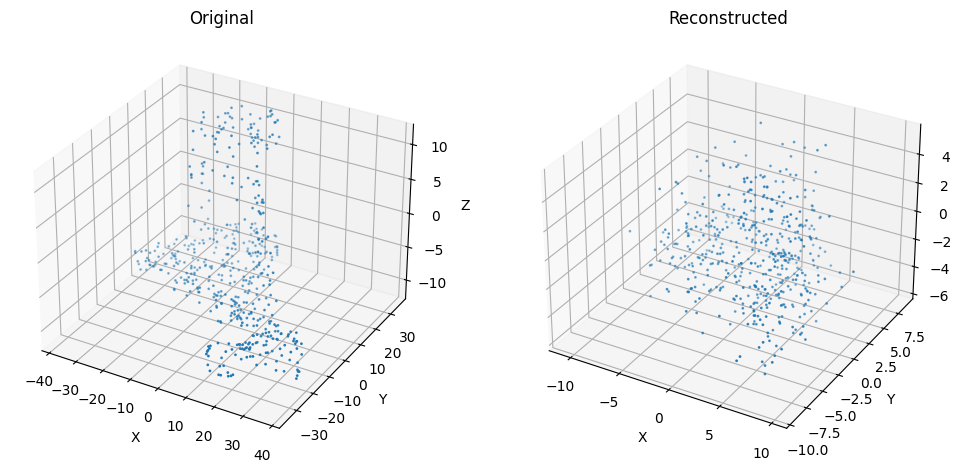

Training Point Cloud 3/11 with Autoencoder
Epoch 10, Loss: 0.19954760372638702


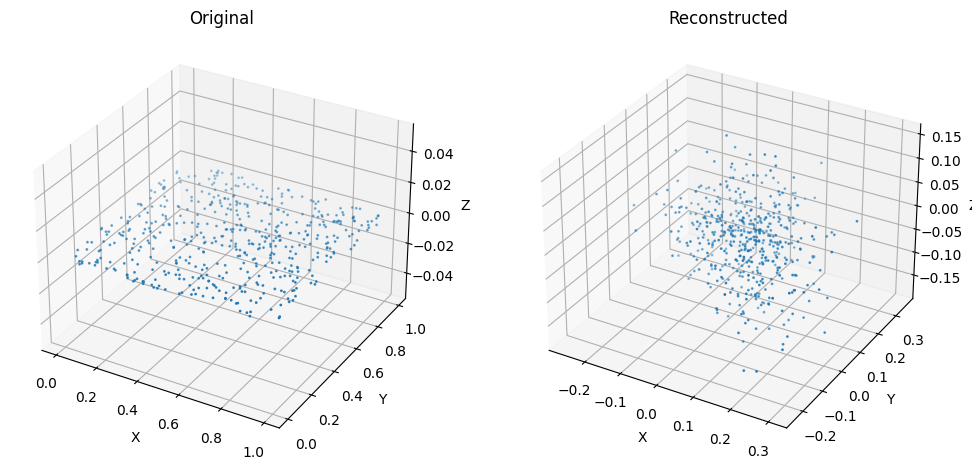

Training Point Cloud 4/11 with Autoencoder
Epoch 10, Loss: 0.2924906313419342


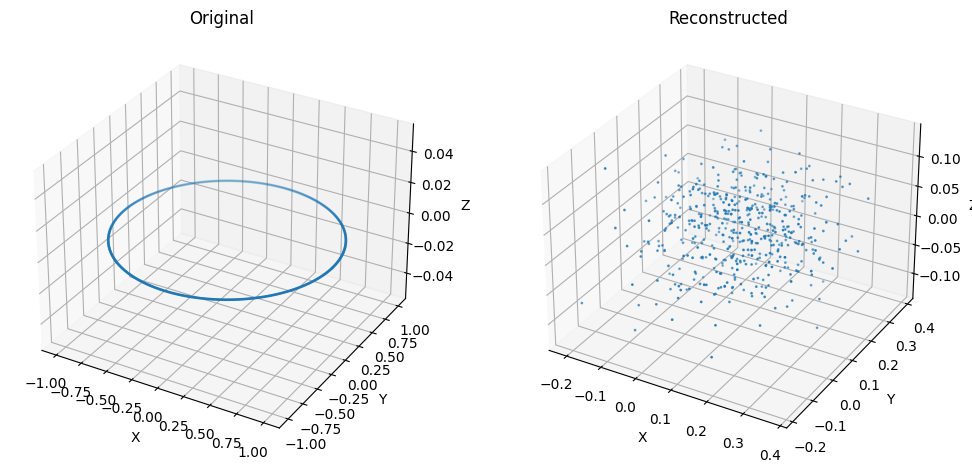

Training Point Cloud 5/11 with Autoencoder
Epoch 10, Loss: 0.16498039662837982


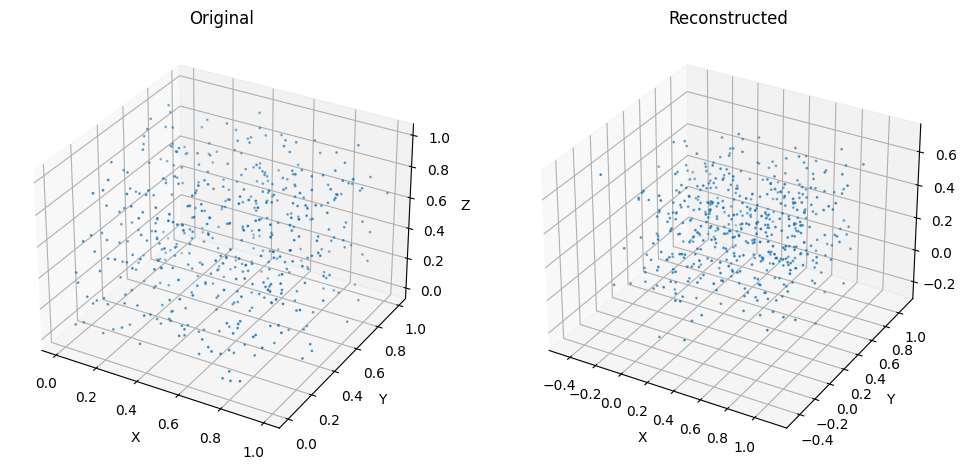

Training Point Cloud 6/11 with Autoencoder
Epoch 10, Loss: 202.13092041015625


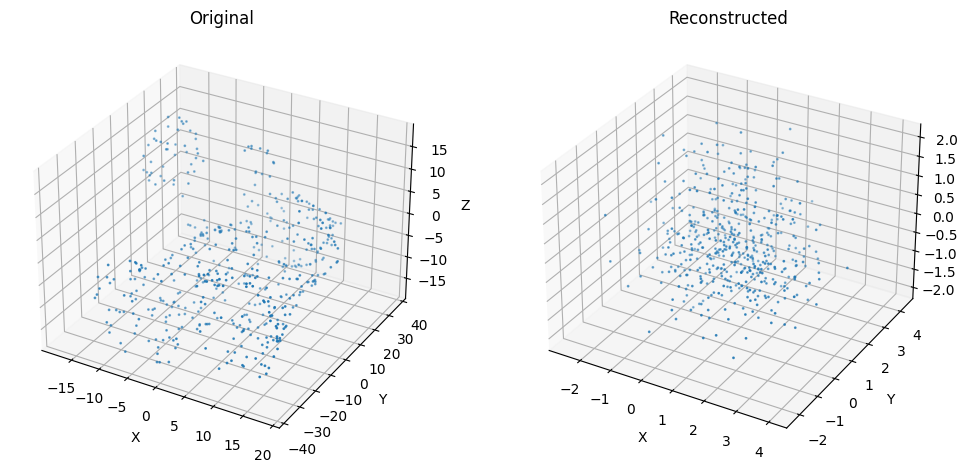

Training Point Cloud 7/11 with Autoencoder
Epoch 10, Loss: 0.43975964188575745


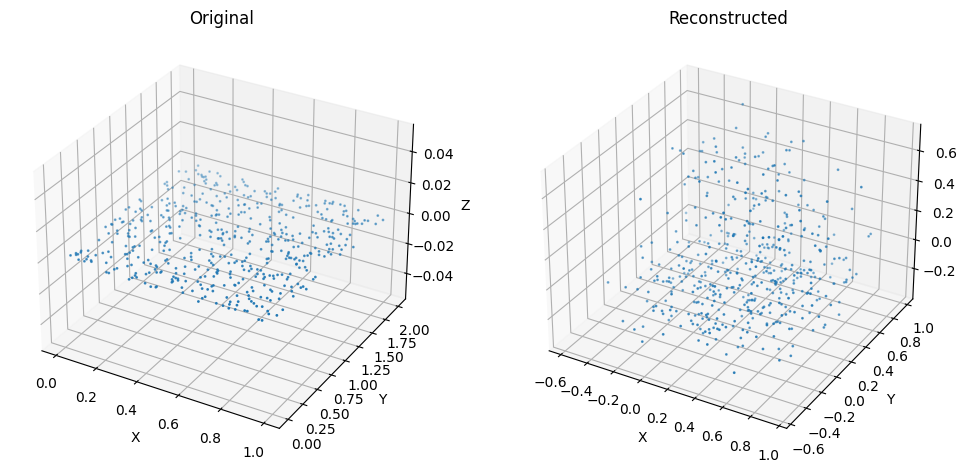

Training Point Cloud 8/11 with Autoencoder
Epoch 10, Loss: 289.057861328125


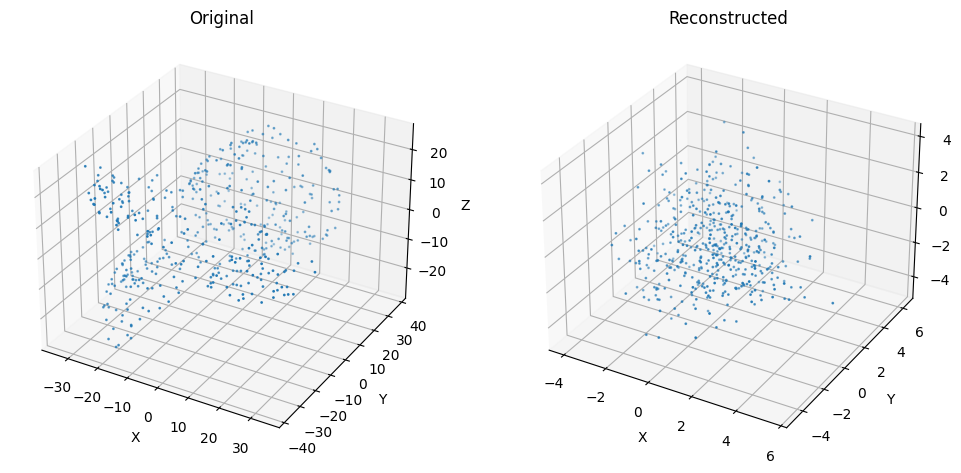

Training Point Cloud 9/11 with Autoencoder
Epoch 10, Loss: 229.8238983154297


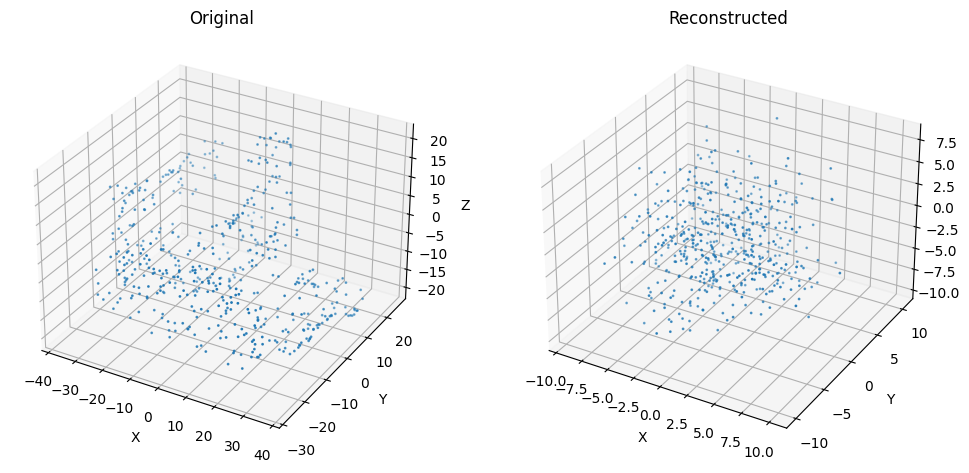

Training Point Cloud 10/11 with Autoencoder
Epoch 10, Loss: 0.38727784156799316


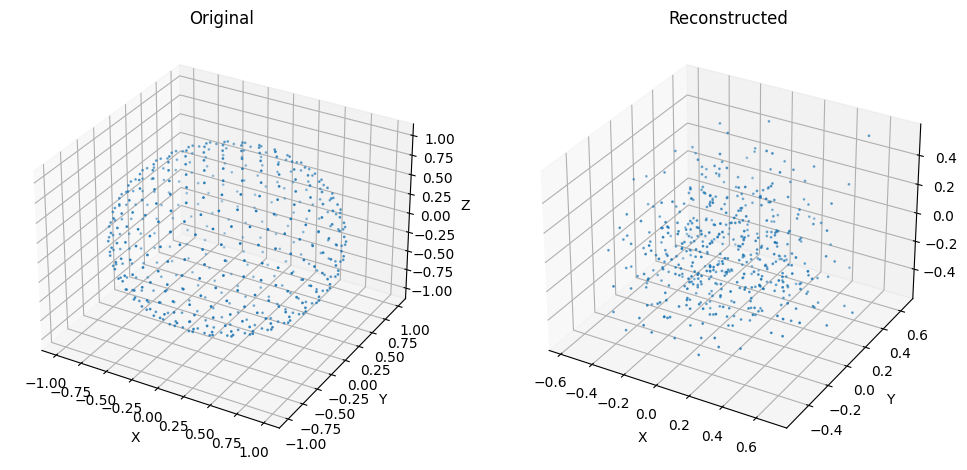

Training Point Cloud 11/11 with Autoencoder
Epoch 10, Loss: 1.7015964984893799


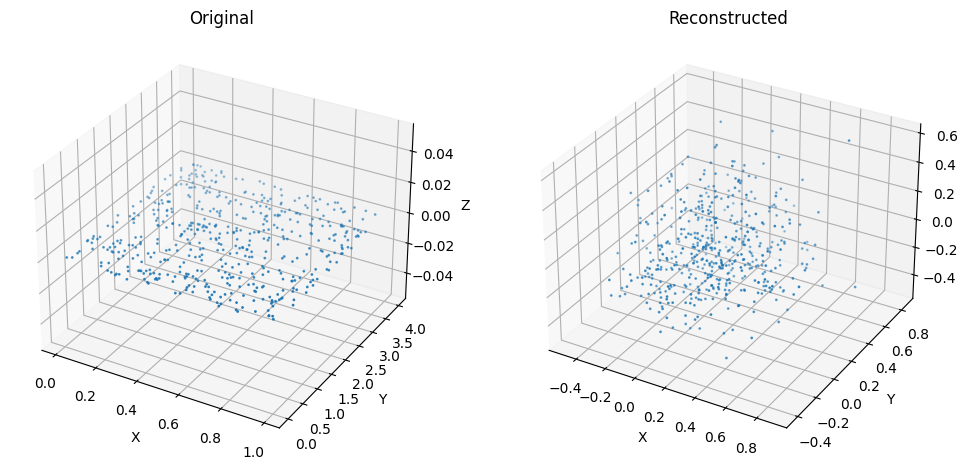

In [163]:
latent_sizes = [64, 128]  # Example latent sizes to experiment with
device = "cuda"

for latent_size in latent_sizes:
    print(f"Training with latent size: {latent_size}\n\n\n\n\n")
    autoencoder = PointNetAutoencoder(num_points=min_points, latent_size=latent_size).to(device)
    trainer.train_and_visualize_using_different_autoencoders_on_multiple_pointclouds(autoencoder, processor.point_clouds, epochs=10, lr=0.001, visualize_every_n_epochs=10, condition=True)

Training with latent size: 64






Epoch 10, Loss: 0.07694636285305023


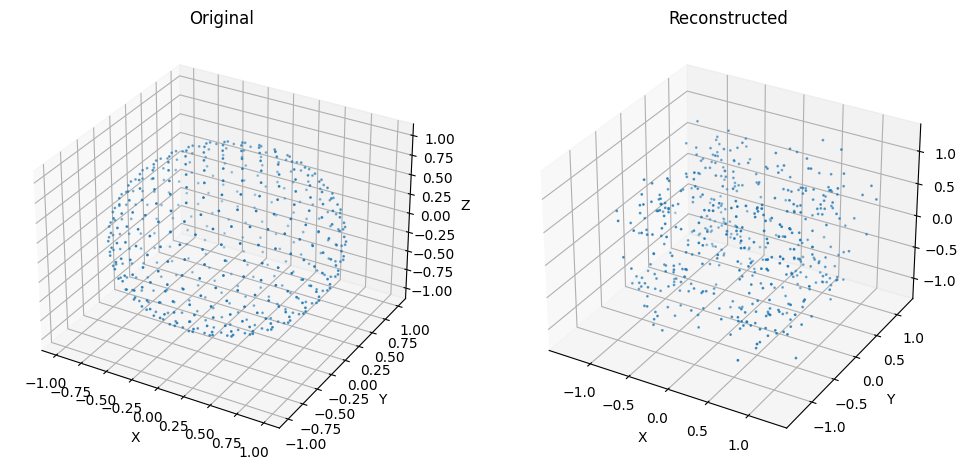

Epoch 20, Loss: 0.014396804384887218


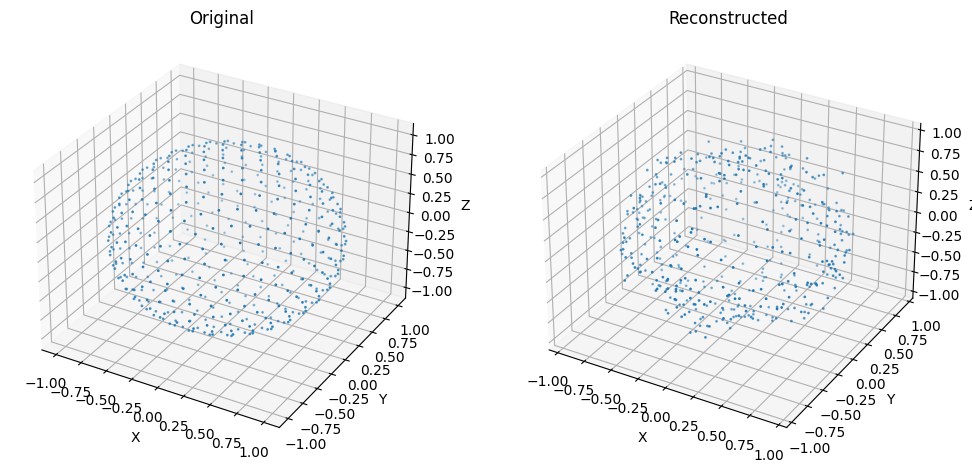

Epoch 30, Loss: 0.004926534369587898


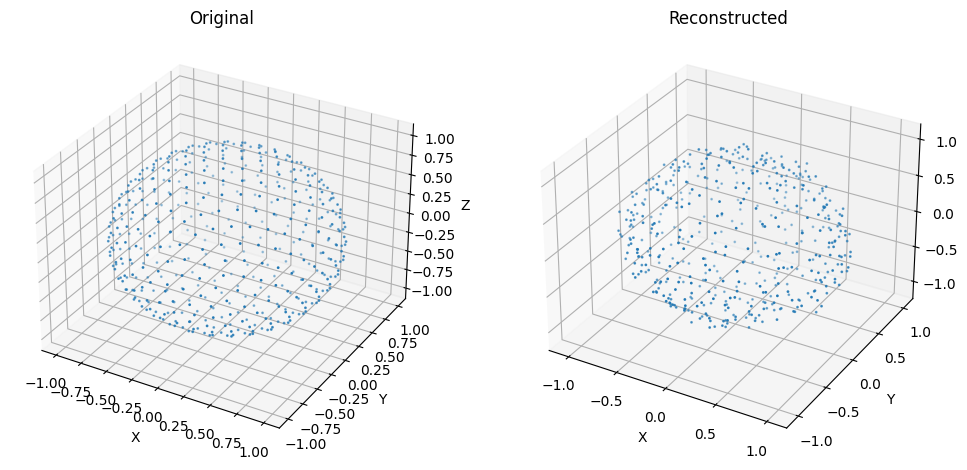

Epoch 40, Loss: 0.001905039418488741


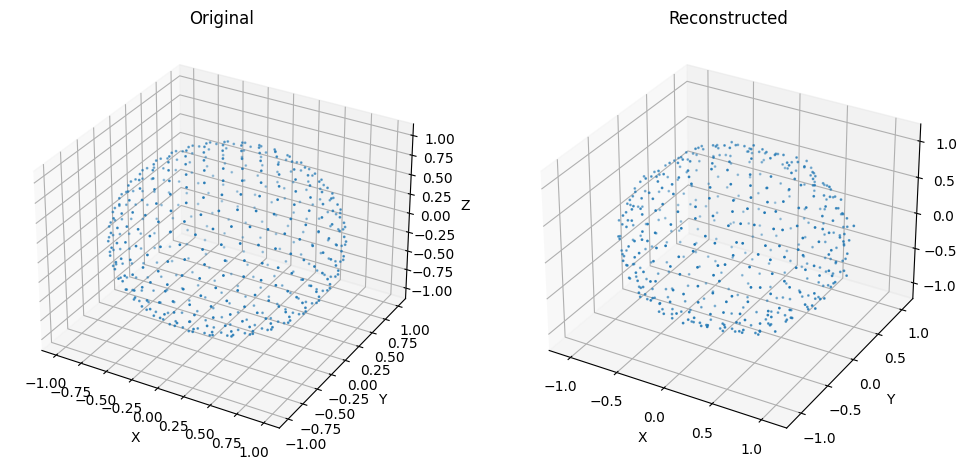

Epoch 50, Loss: 0.0005313048604875803


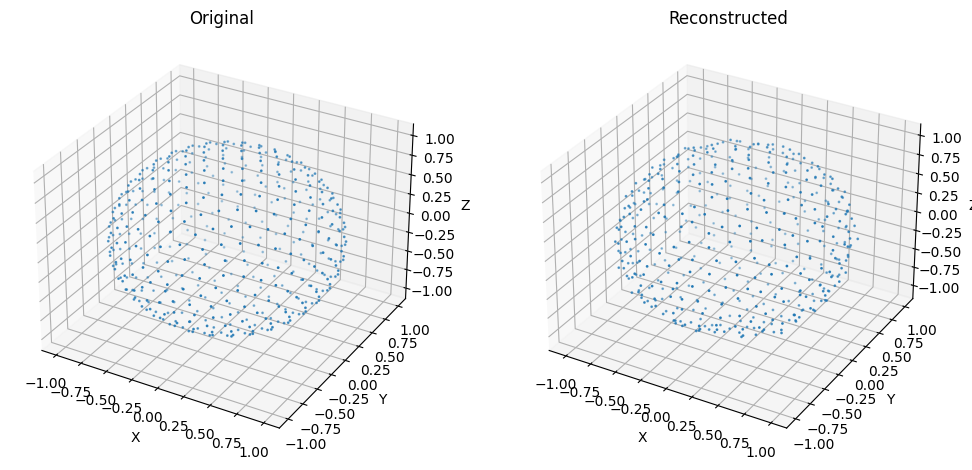

Training with latent size: 128






Epoch 10, Loss: 0.07833302021026611


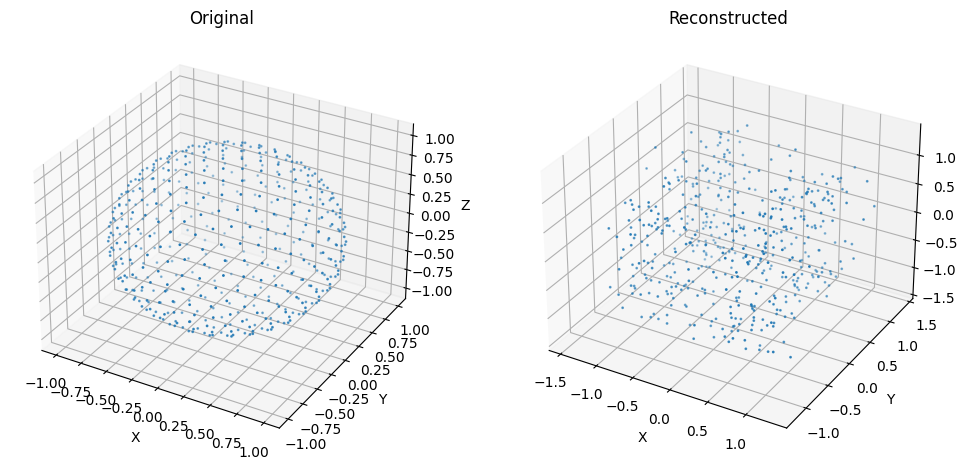

Epoch 20, Loss: 0.014248901046812534


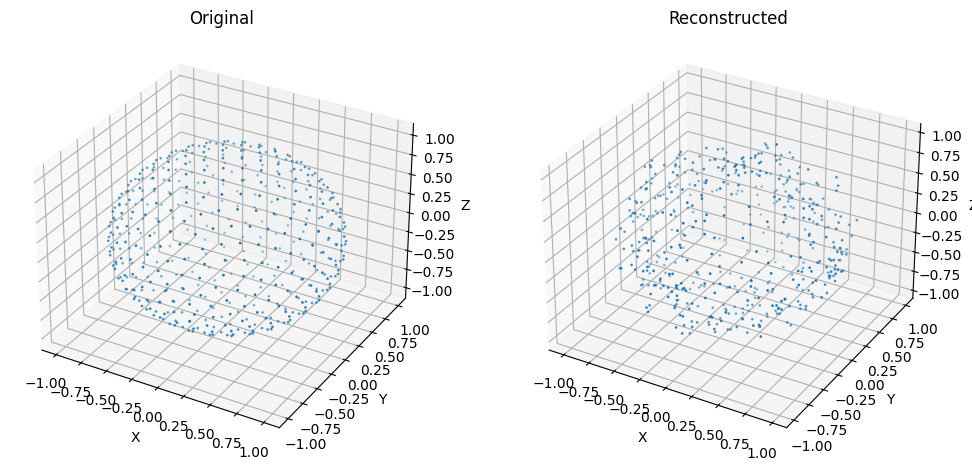

Epoch 30, Loss: 0.005327997263520956


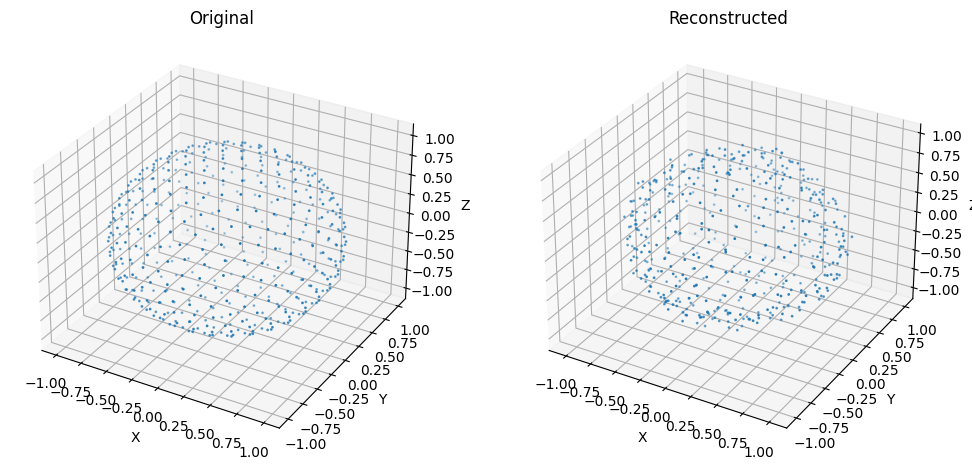

Epoch 40, Loss: 0.0016773511888459325


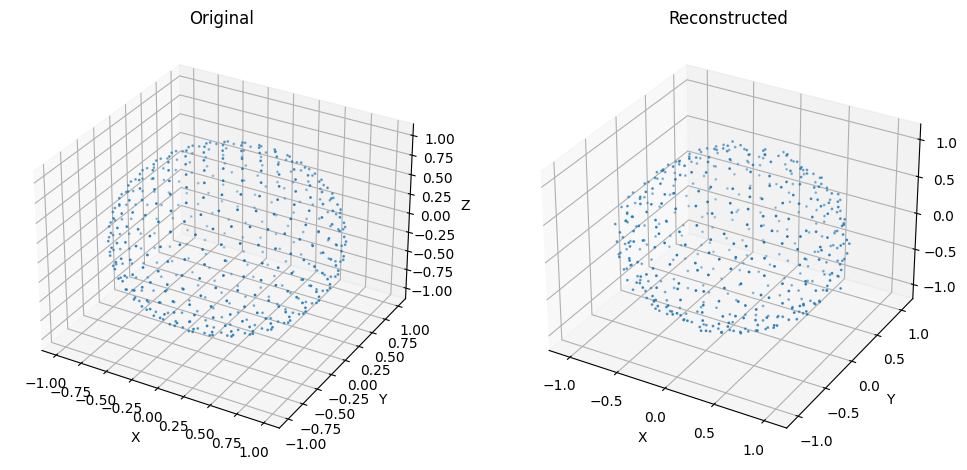

Epoch 50, Loss: 0.0007167767616920173


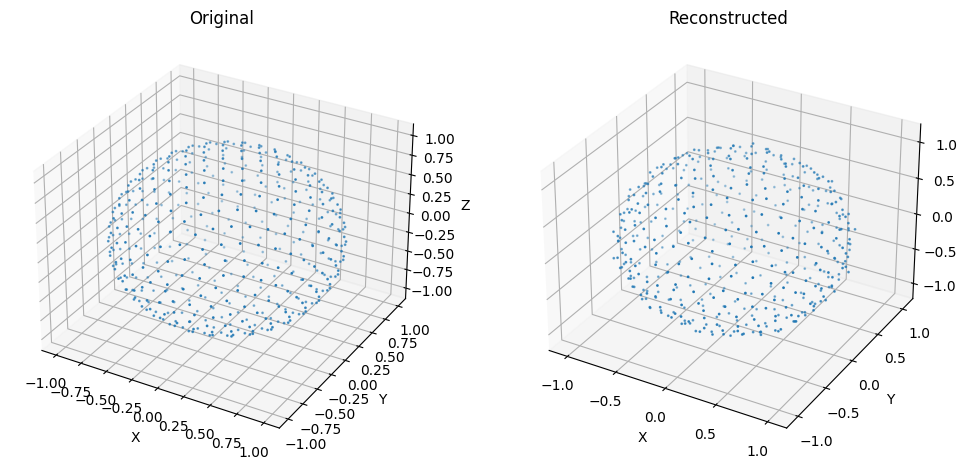

In [164]:
latent_sizes = [64, 128]  # Example latent sizes to experiment with
device = "cuda"

for latent_size in latent_sizes:
    print(f"Training with latent size: {latent_size}\n\n\n\n\n\n")
    autoencoder = PointNetAutoencoder(num_points=min_points, latent_size=latent_size).to(device)
    trainer.train_and_visualize_using_different_autoencoders_on_single_pointcloud(autoencoder, processor.point_clouds[9], epochs=50, lr=0.001, visualize_every_n_epochs=10, condition=True)

Training with latent size: 64
Training with latent size: 128
Training with latent size: 256
Training with latent size: 512


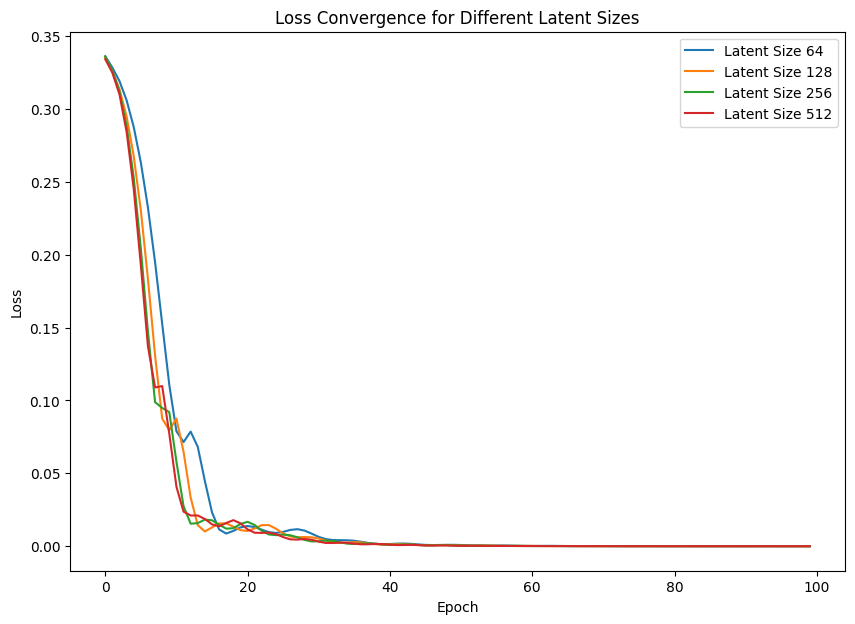

In [166]:
# Example usage
# latent_sizes = [8, 16, 32, 64, 128, 256, 512, 1024, 2048]
latent_sizes = [64, 128, 256, 512]
point_cloud_index = 9  # Example point cloud index
epochs = 100

trainer.plot_loss_convergence_for_latent_sizes(latent_sizes, min_points, processor.point_clouds, point_cloud_index, epochs)



In [167]:
model = trainer.train_and_visualize_on_single_point_cloud(processor.point_clouds[9], epochs=50, lr=0.001, visualize_every_n_epochs=10)

Epoch 10, Loss: 0.07847544550895691
Epoch 20, Loss: 0.0140299741178751
Epoch 30, Loss: 0.005447803996503353
Epoch 40, Loss: 0.0016779896104708314
Epoch 50, Loss: 0.0007205078727565706


In [168]:
pc = processor.point_clouds[4]
trainer.encode_point_cloud(model, pc)

array([ 3.68732035e-01,  3.07015359e-01,  1.56487077e-01,  1.98006749e-01,
        2.34640181e-01,  4.52674478e-01, -5.65764122e-02,  1.00978732e-01,
       -1.97960168e-01, -5.60642779e-03,  1.29040644e-01,  3.86052072e-01,
       -9.17657018e-02,  2.69355267e-01,  1.65639639e-01,  1.60825834e-01,
       -1.47692859e-02,  4.51385260e-01,  4.05550674e-02,  1.00092918e-01,
       -1.33044749e-01, -1.61275789e-01,  2.18637973e-01,  2.57219136e-01,
        1.42059311e-01,  2.35155597e-01, -8.43934119e-02,  4.49228287e-01,
        1.23018347e-01, -2.76084766e-02,  1.02676347e-01,  1.09705493e-01,
        3.79242152e-02,  1.97879598e-01,  5.92525452e-02,  5.62603176e-02,
       -1.59626365e-01, -1.04741462e-01, -8.02188143e-02,  6.60798922e-02,
       -8.90164897e-02,  1.22587010e-01,  5.67067042e-02,  2.26751715e-03,
        1.76457316e-02, -1.80975229e-01,  3.09636652e-01,  7.95681998e-02,
        1.45651728e-01,  2.66184330e-01,  4.95730713e-02,  2.37299263e-01,
        5.44520132e-02,  

In [169]:
# Configuration
config = {
        "folder_dir": "./simple-3d-objects",
        "show_loaded_pointclouds": True,
        "train_dim": 64,
        "test_dims": [64, 128, 256, 512, 1024, 2048],
        "min_points": 500,
        "epochs": 50,
        "lr": 0.001,
        "visualize_every_n_epochs": 10,
        "visualize_training": True,
        "test_pointcloud_path": "/content/simple-3d-objects/sphere_point_cloud.ply"
}

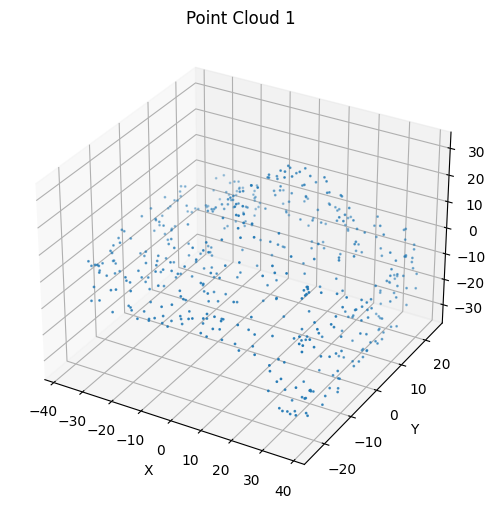

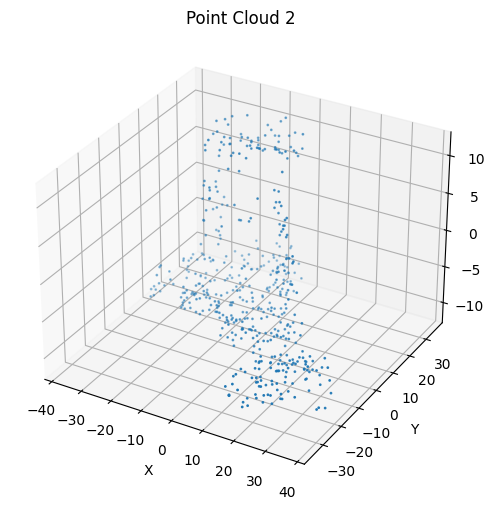

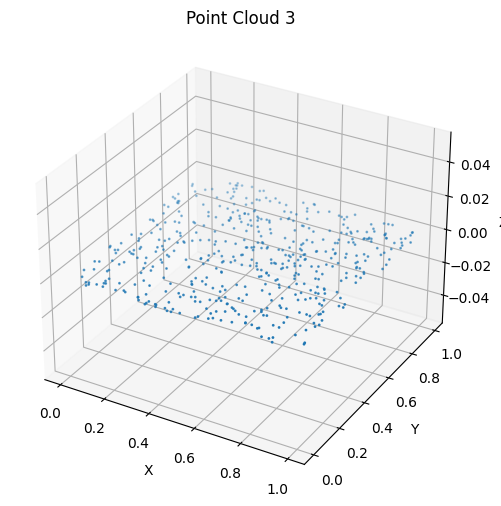

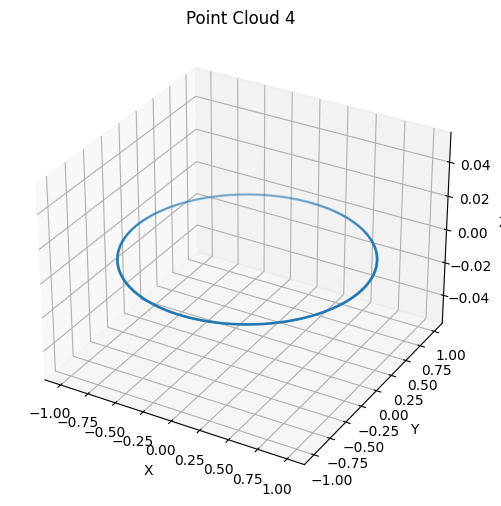

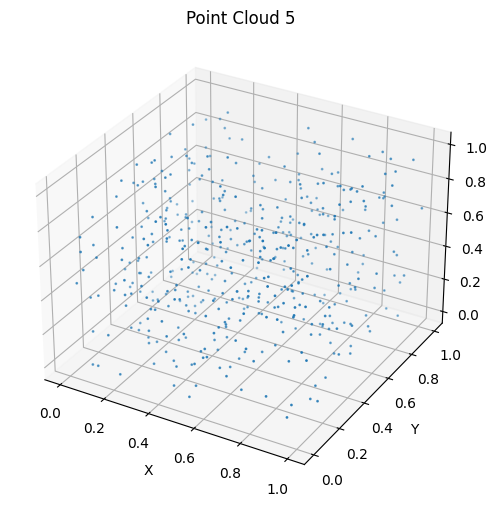

...

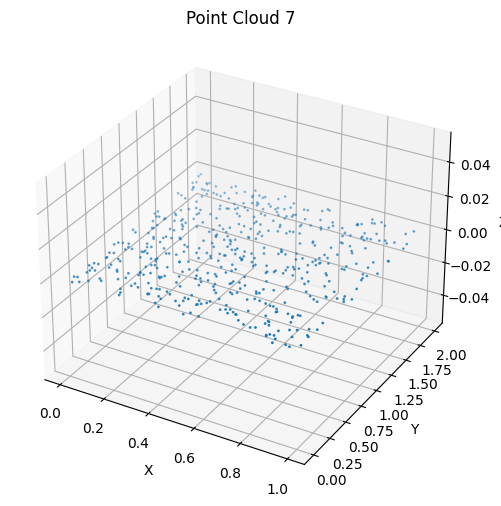

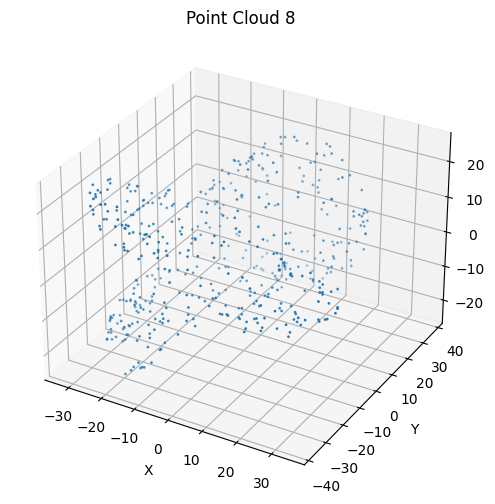

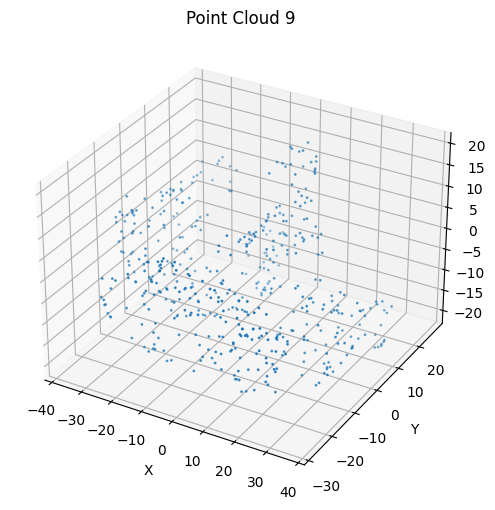

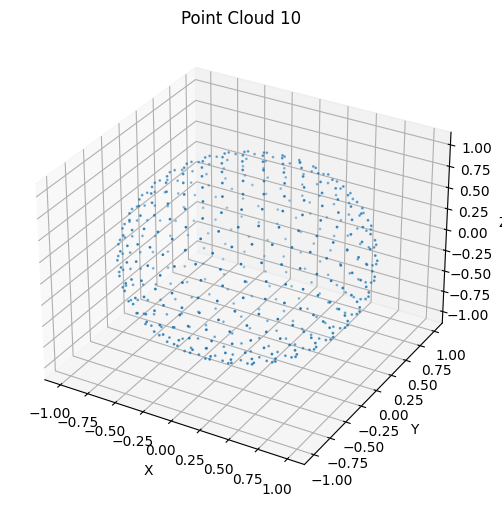

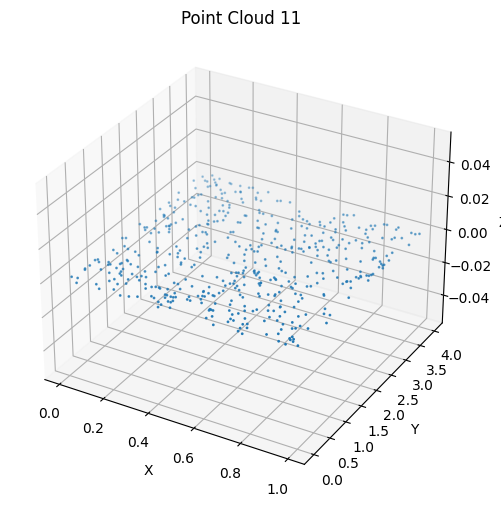

Training on all point clouds...
Training Point Cloud 1/11
Epoch 10, Loss: 113.40497589111328


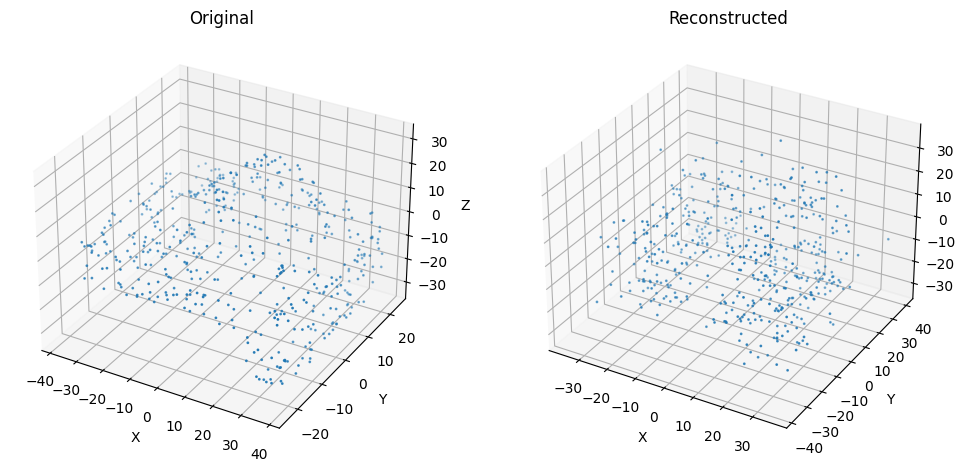

Epoch 20, Loss: 16.658903121948242


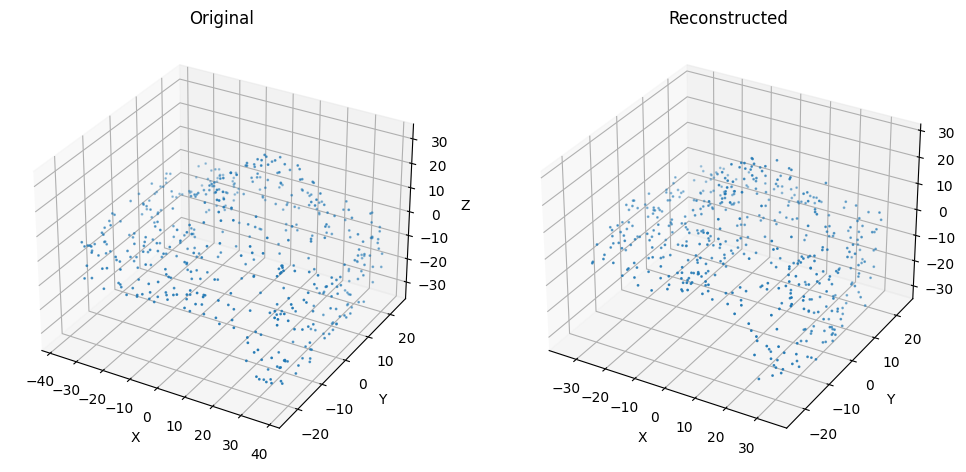

Epoch 30, Loss: 6.641057014465332


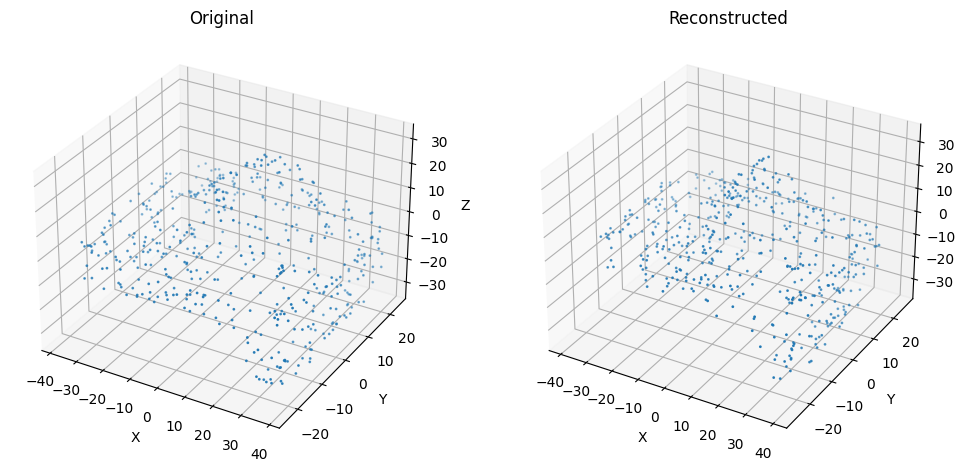

Epoch 40, Loss: 2.382892608642578


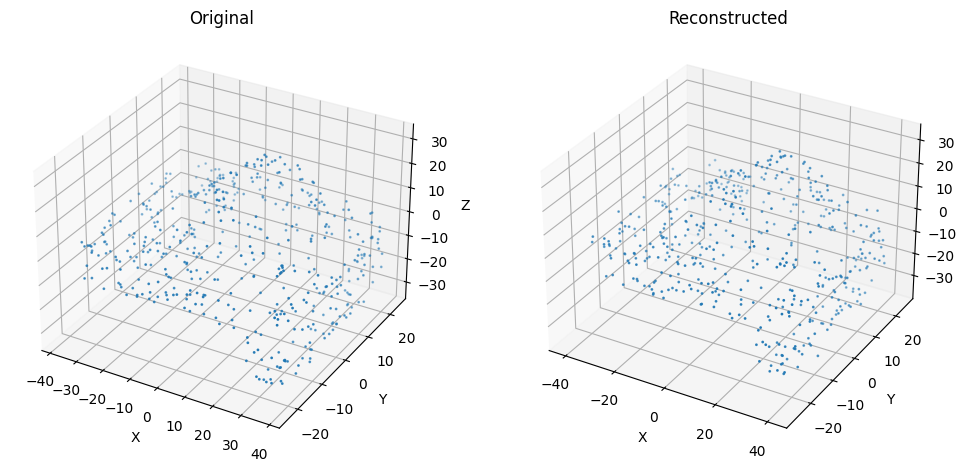

Epoch 50, Loss: 0.8382605910301208


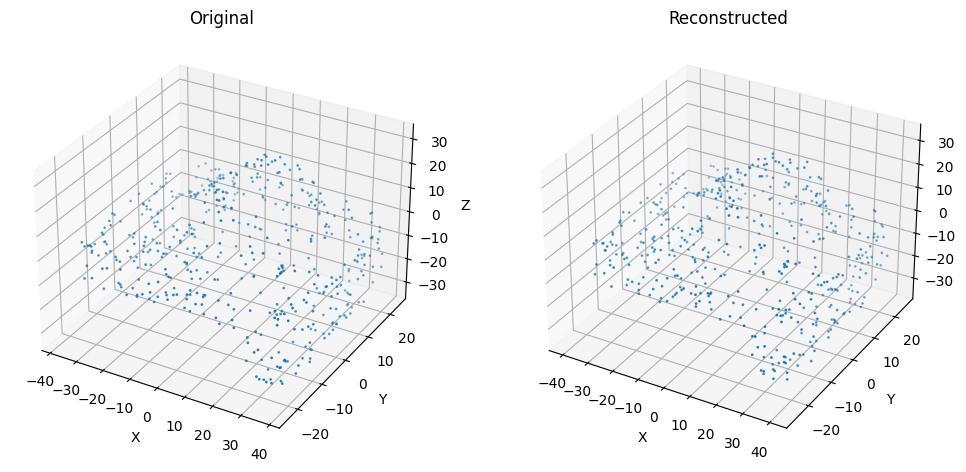

Training Point Cloud 2/11
Epoch 10, Loss: 85.22819519042969


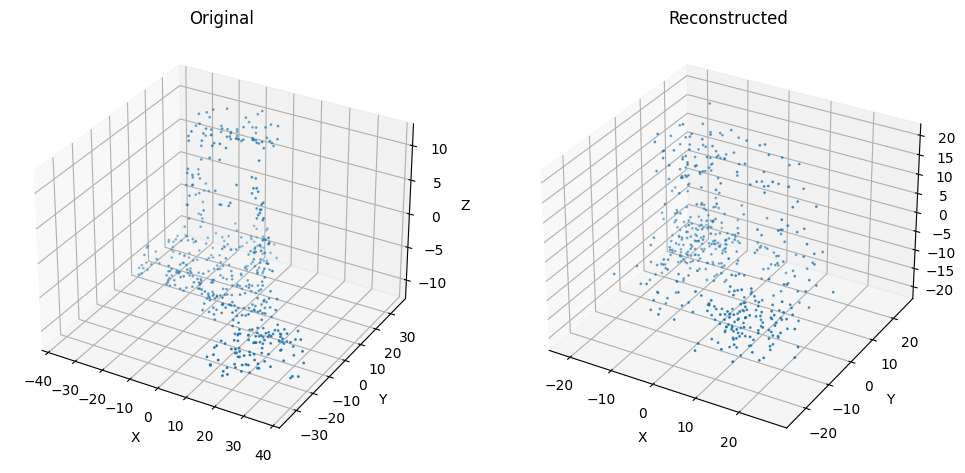

Epoch 20, Loss: 11.412598609924316


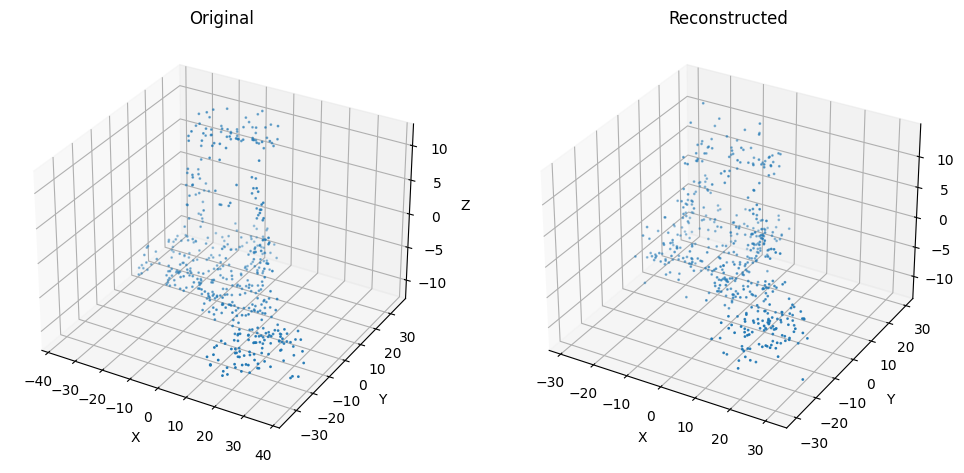

Epoch 30, Loss: 4.402595043182373


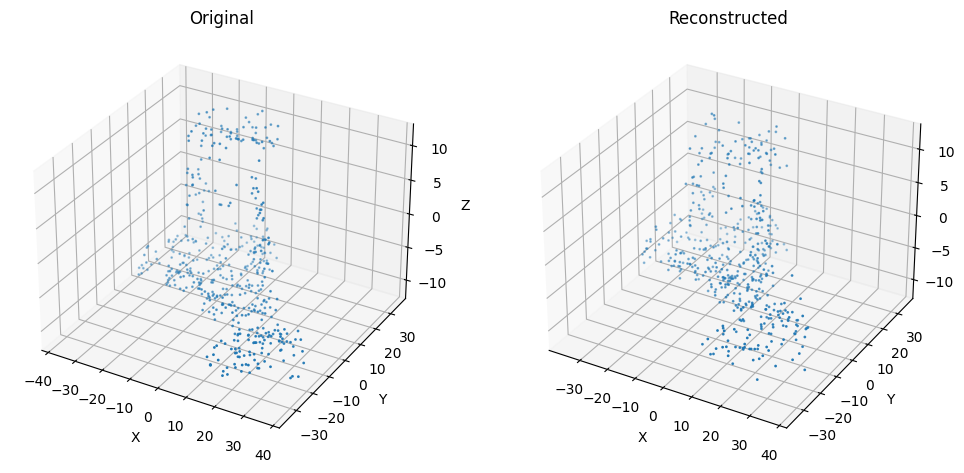

Epoch 40, Loss: 1.7202398777008057


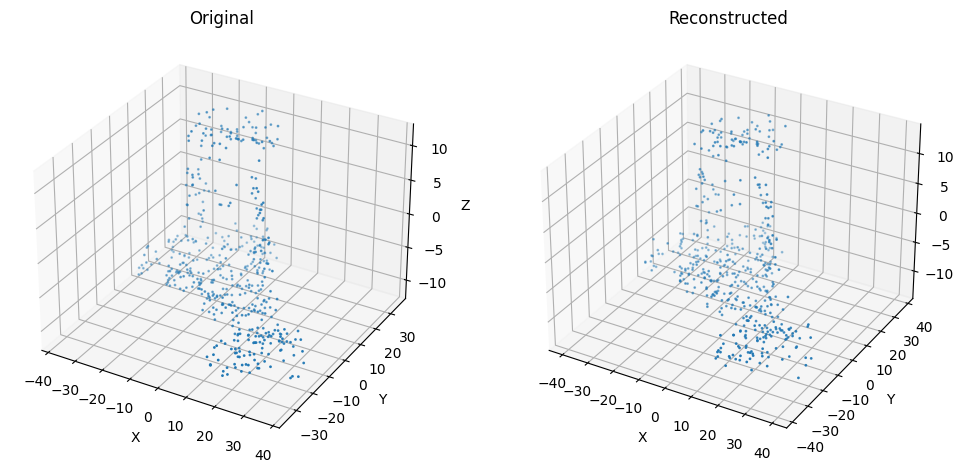

Epoch 50, Loss: 0.5365545749664307


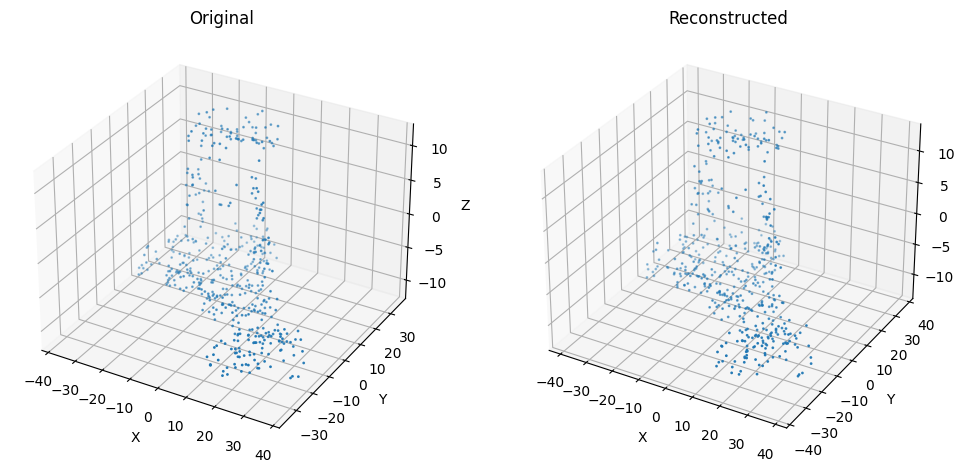

Training Point Cloud 3/11
Epoch 10, Loss: 0.052922677248716354


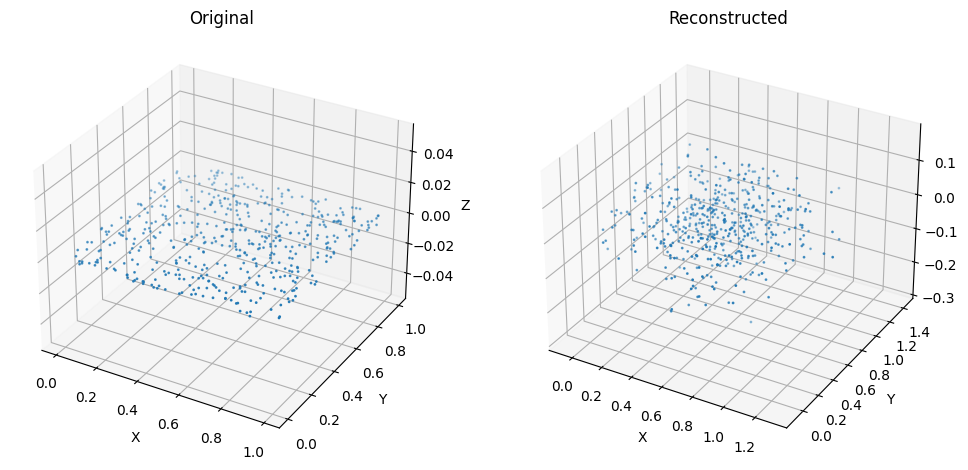

Epoch 20, Loss: 0.010048514232039452


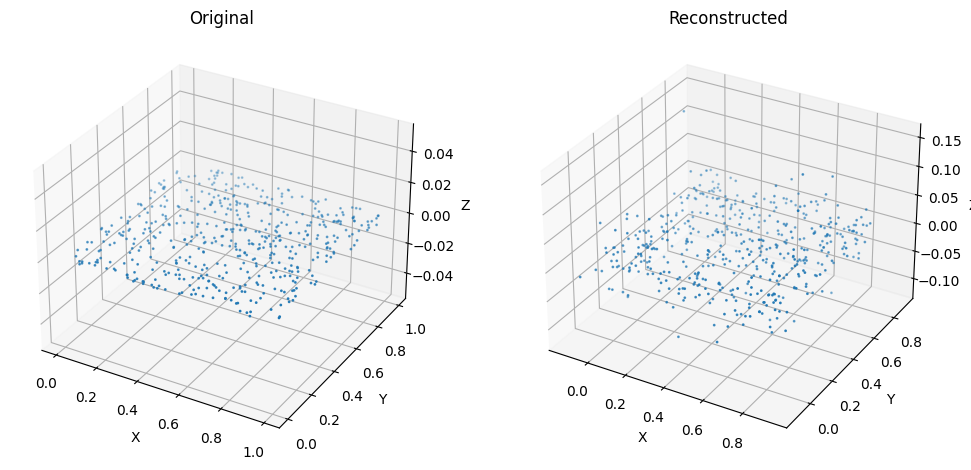

Epoch 30, Loss: 0.0036869440227746964


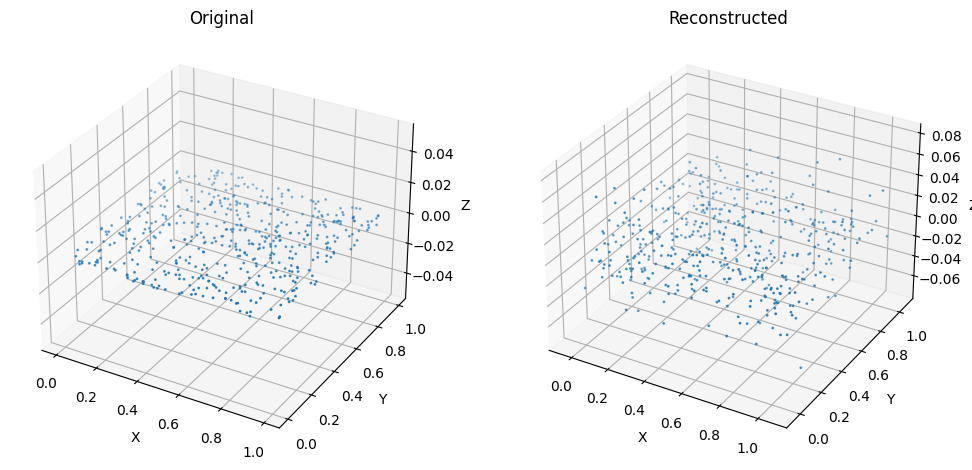

Epoch 40, Loss: 0.0012018679408356547


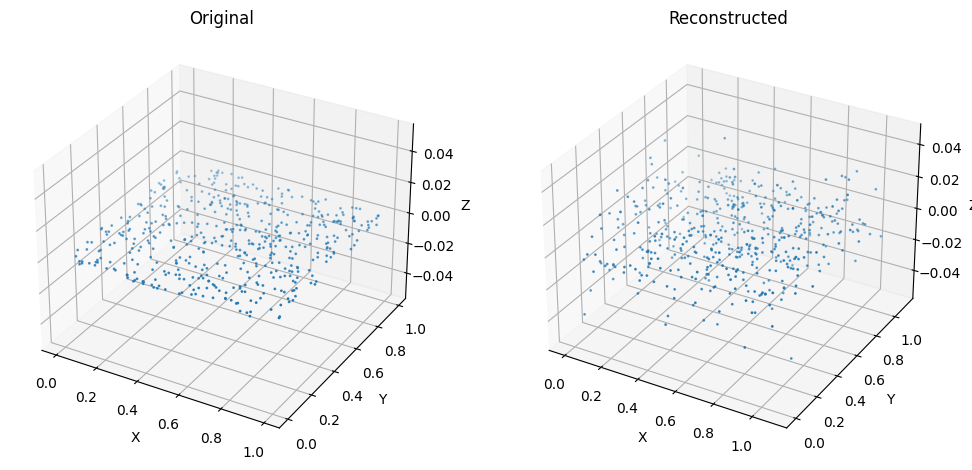

Epoch 50, Loss: 0.0004066316760145128


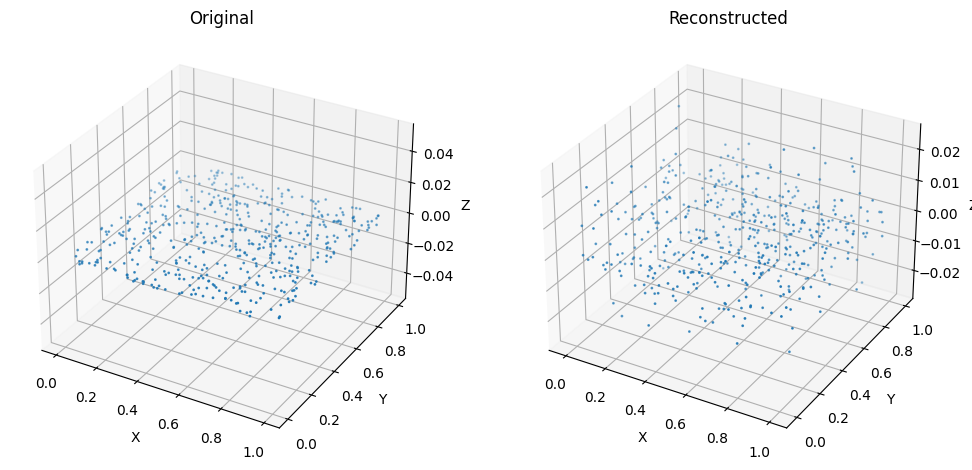

Training Point Cloud 4/11
Epoch 10, Loss: 0.12890936434268951


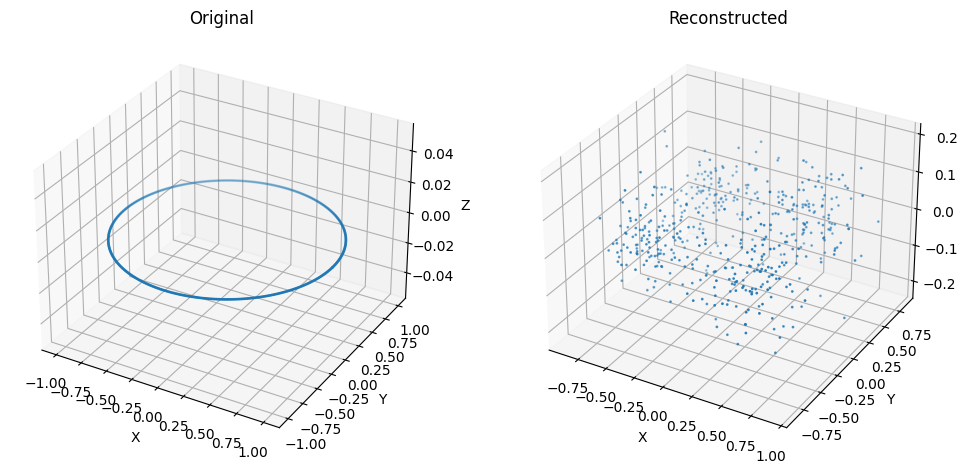

Epoch 20, Loss: 0.008119940757751465


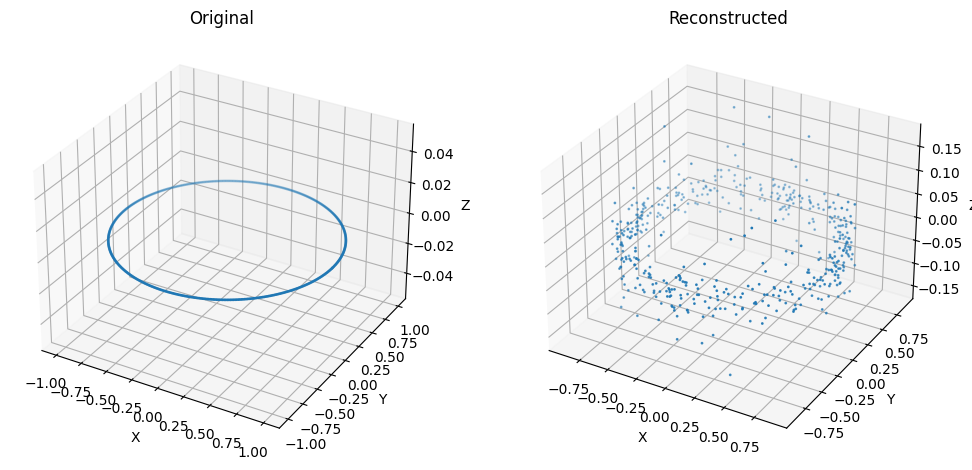

Epoch 30, Loss: 0.010712102055549622


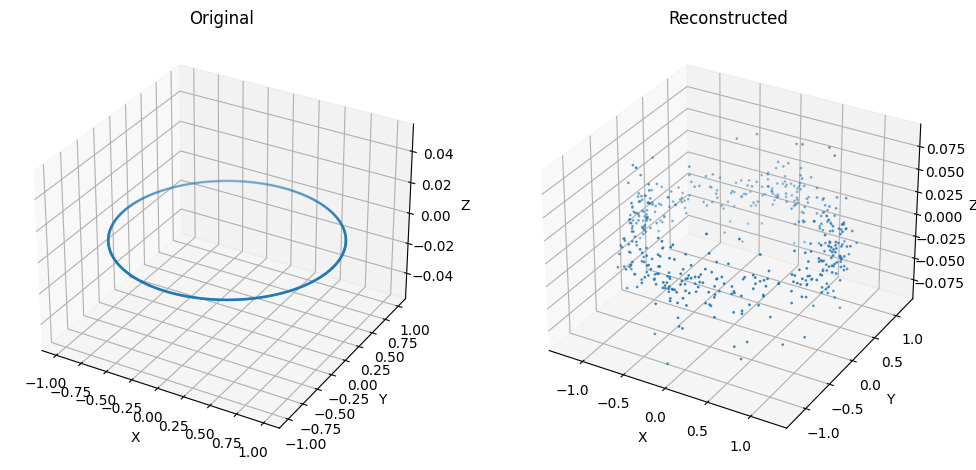

Epoch 40, Loss: 0.0019086434040218592


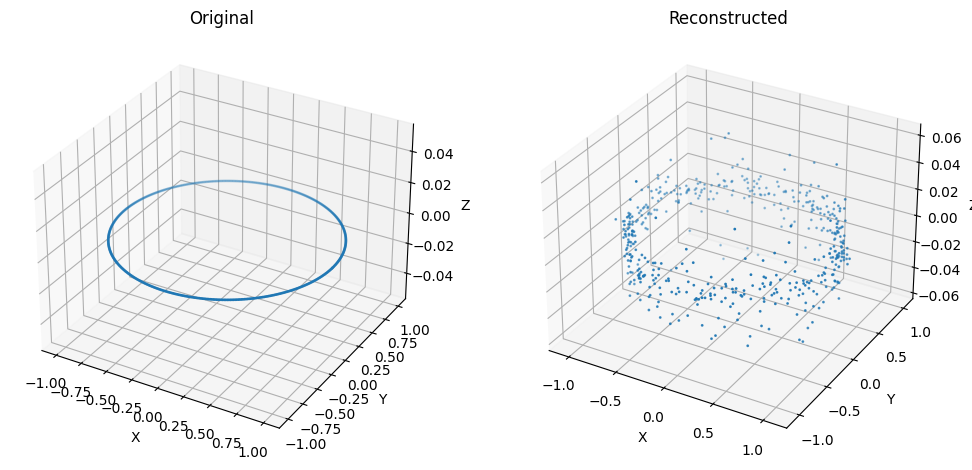

Epoch 50, Loss: 0.0006212735315784812


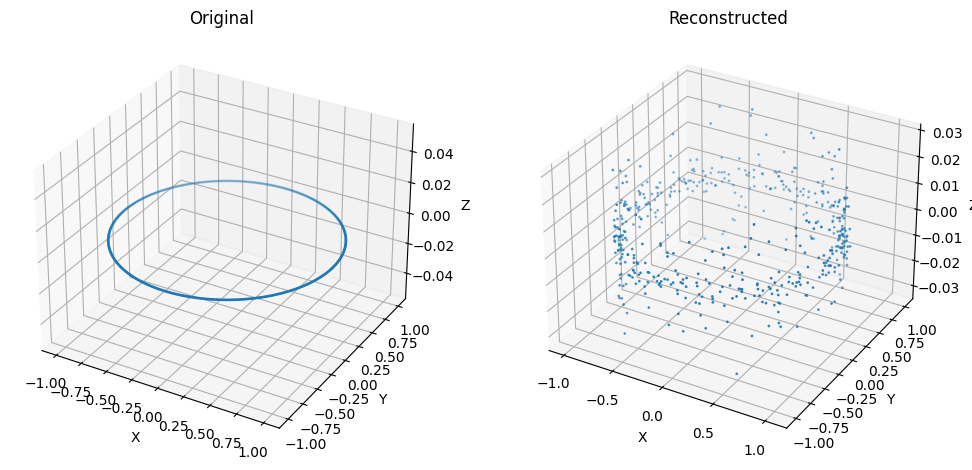

Training Point Cloud 5/11
Epoch 10, Loss: 0.09403233975172043


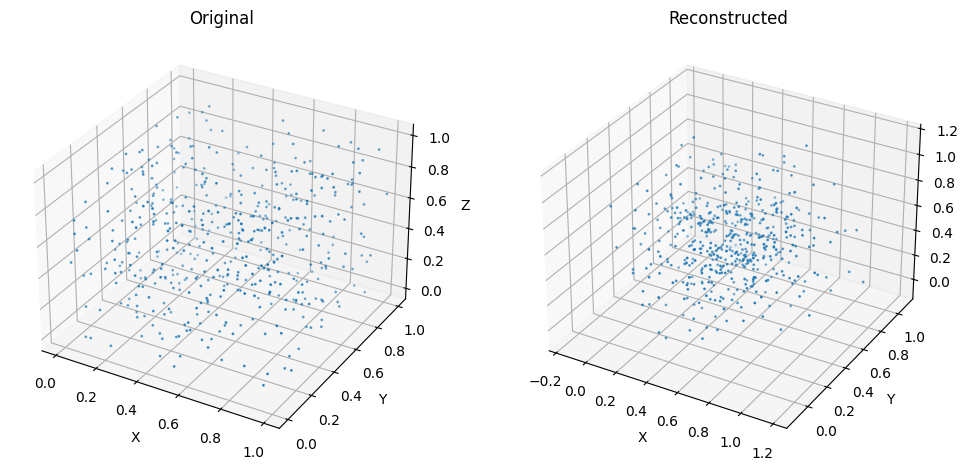

Epoch 20, Loss: 0.013768022879958153


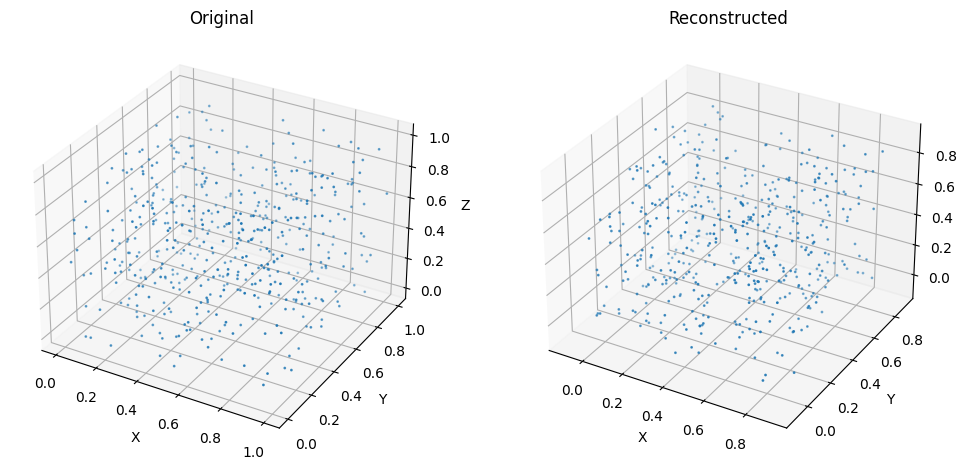

Epoch 30, Loss: 0.005726438015699387


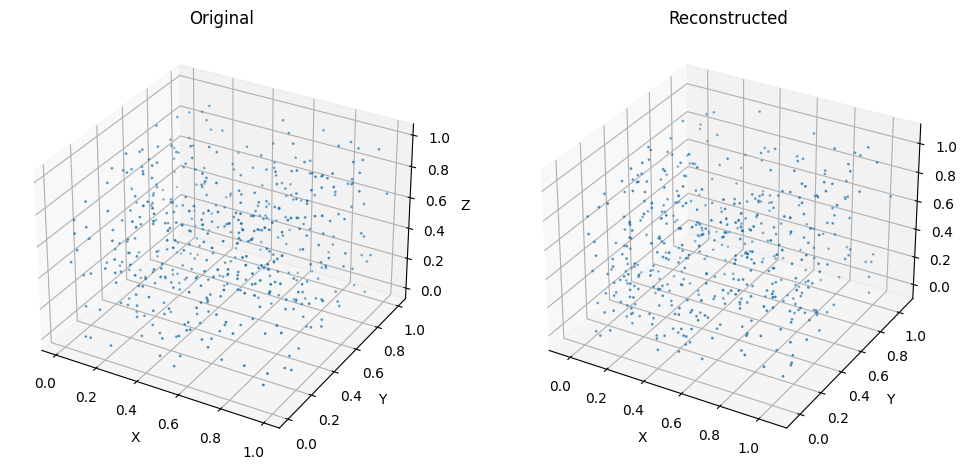

Epoch 40, Loss: 0.001900890958495438


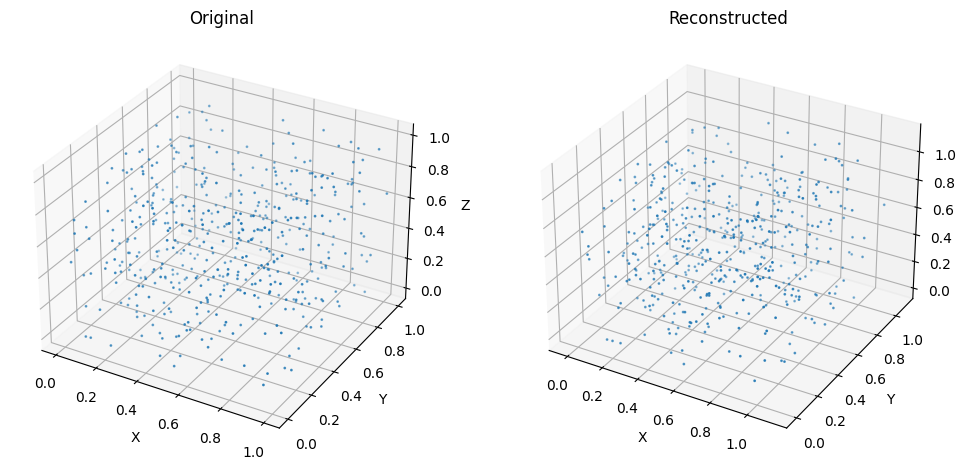

Epoch 50, Loss: 0.0006156413583084941


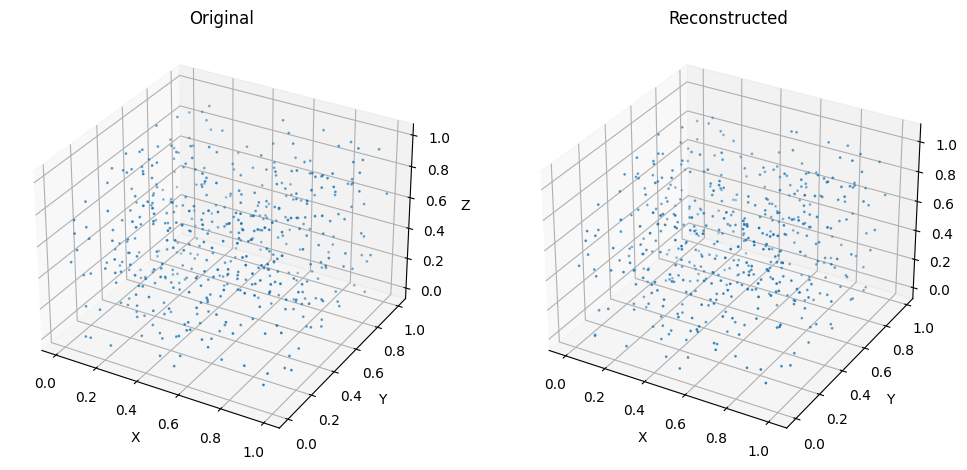

Training Point Cloud 6/11
Epoch 10, Loss: 77.77424621582031


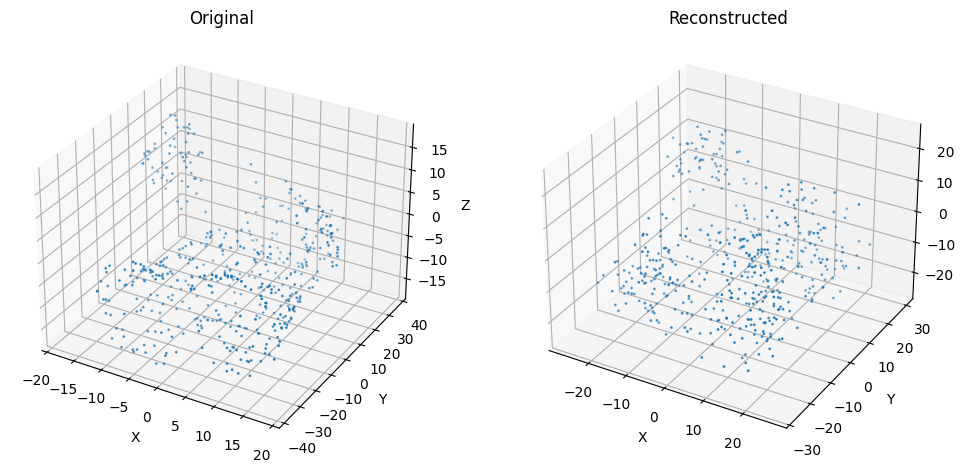

Epoch 20, Loss: 12.727153778076172


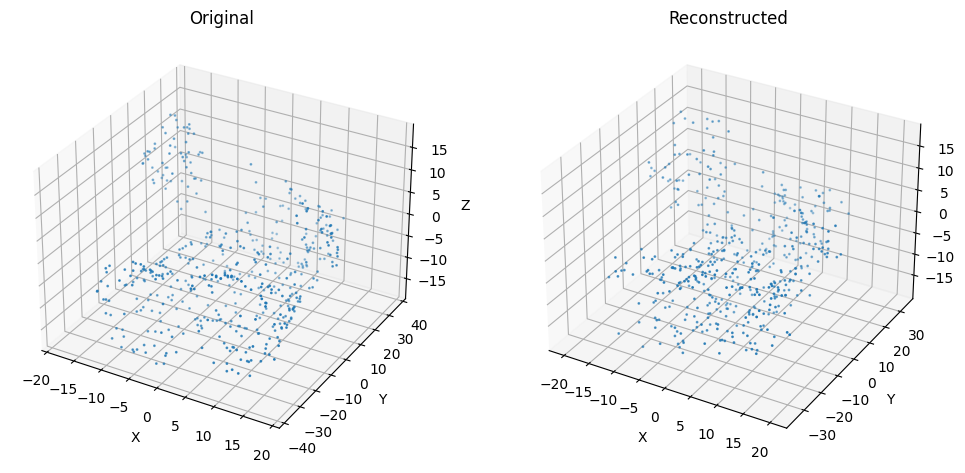

Epoch 30, Loss: 4.018680095672607


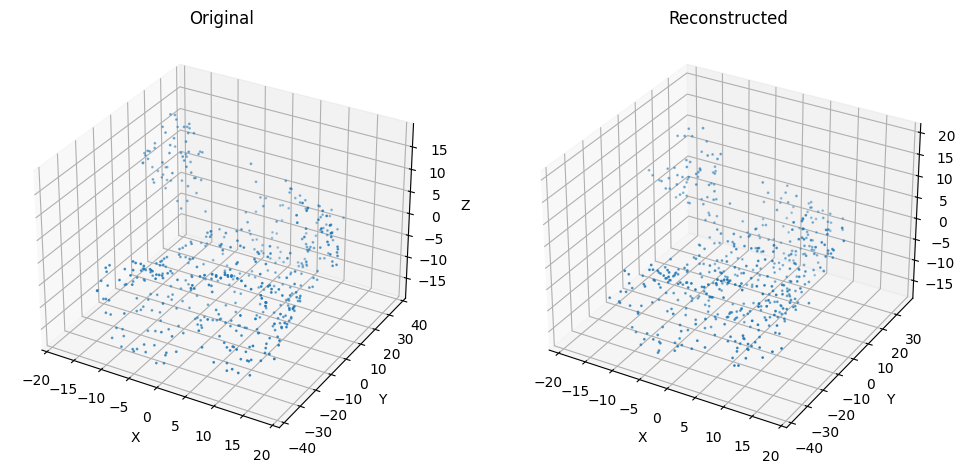

Epoch 40, Loss: 1.497277855873108


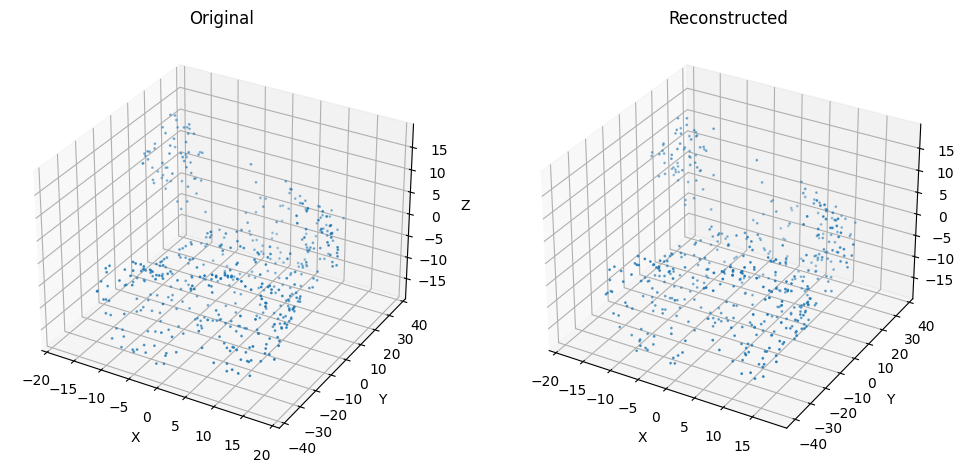

Epoch 50, Loss: 0.6653195023536682


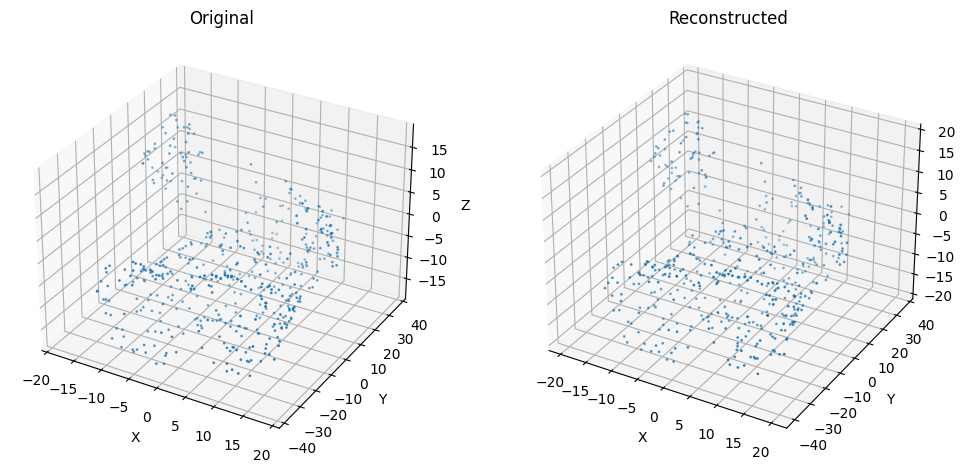

Training Point Cloud 7/11
Epoch 10, Loss: 0.2353309541940689


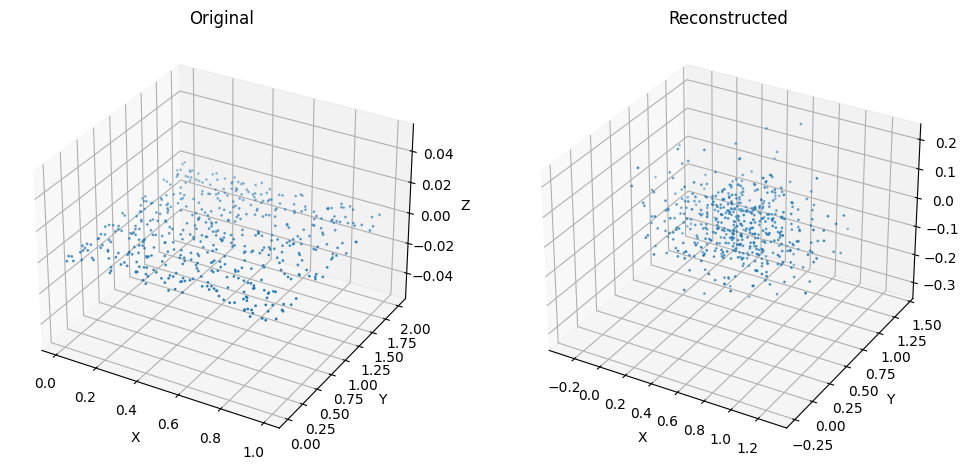

Epoch 20, Loss: 0.026486583054065704


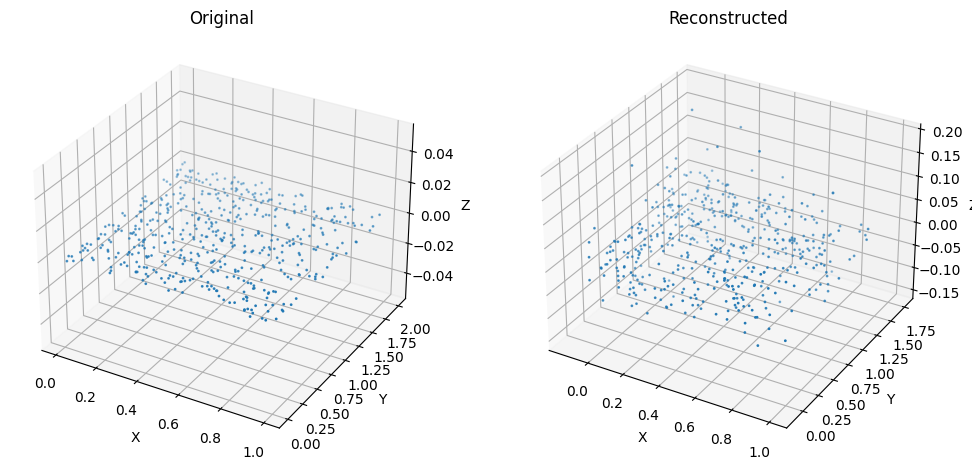

Epoch 30, Loss: 0.0110846608877182


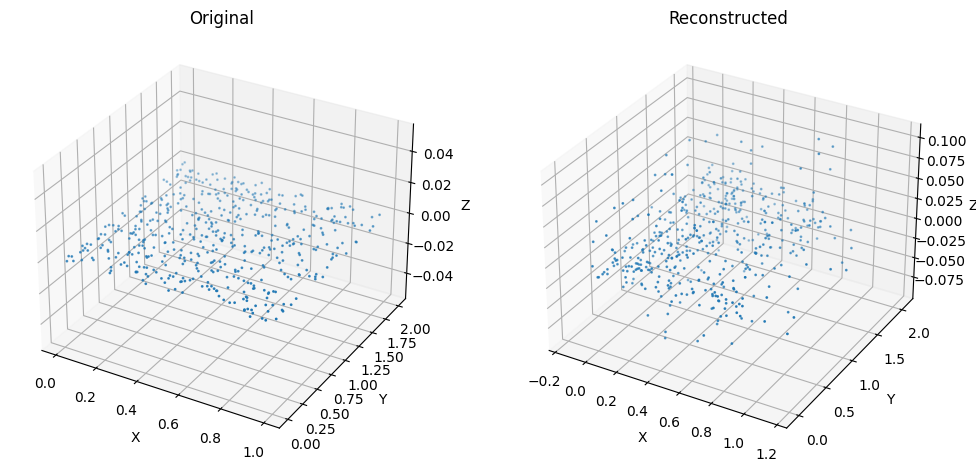

Epoch 40, Loss: 0.003958509769290686


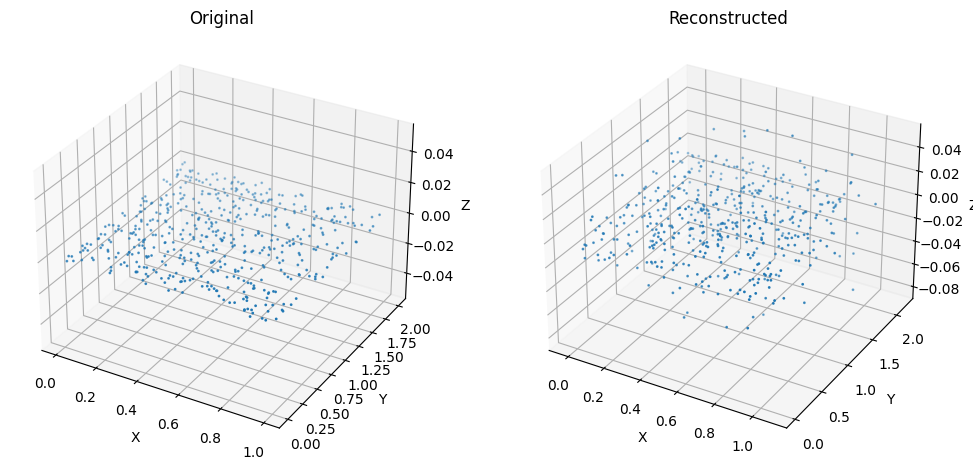

Epoch 50, Loss: 0.001034816144965589


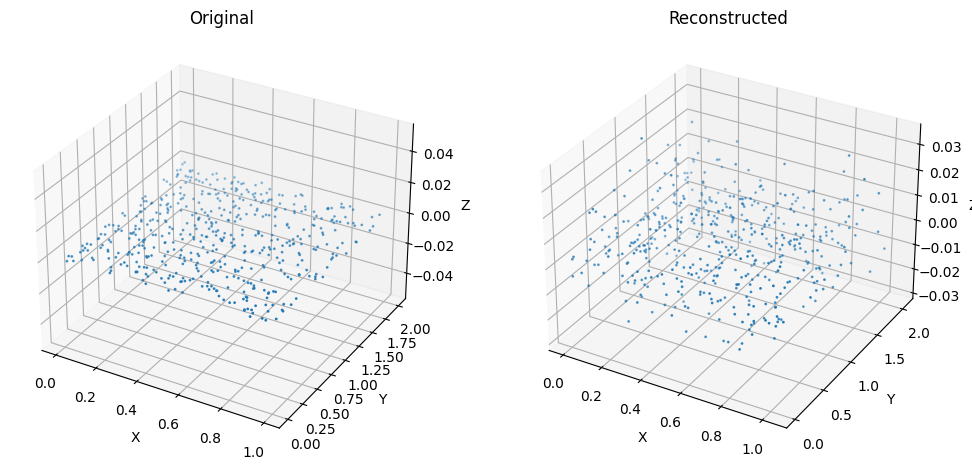

Training Point Cloud 8/11
Epoch 10, Loss: 115.36585235595703


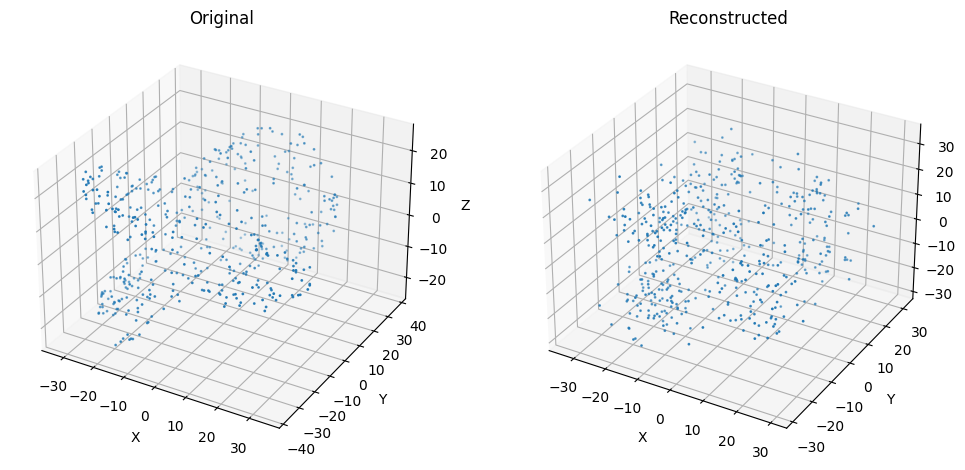

Epoch 20, Loss: 15.924524307250977


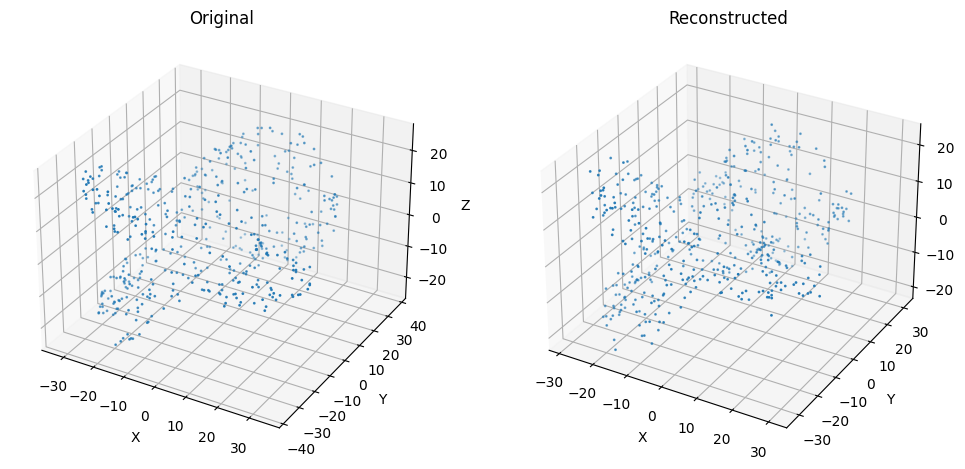

Epoch 30, Loss: 6.502602577209473


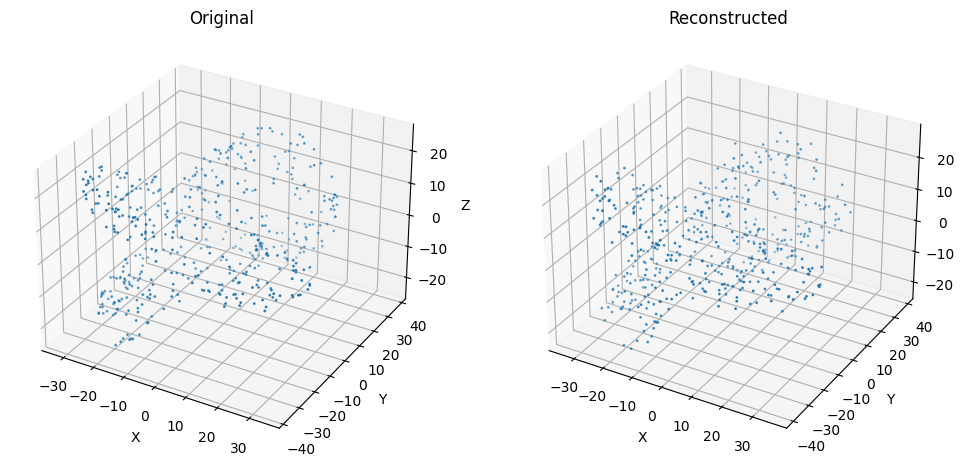

Epoch 40, Loss: 2.6609373092651367


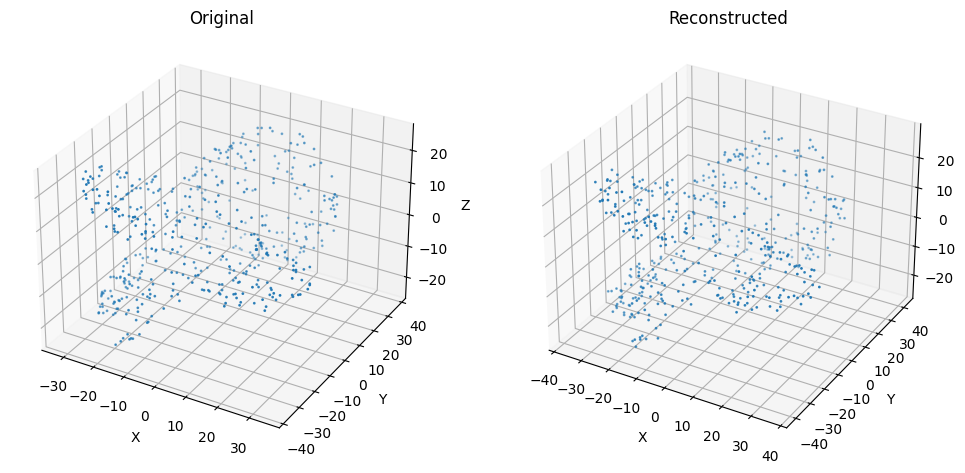

Epoch 50, Loss: 0.5992793440818787


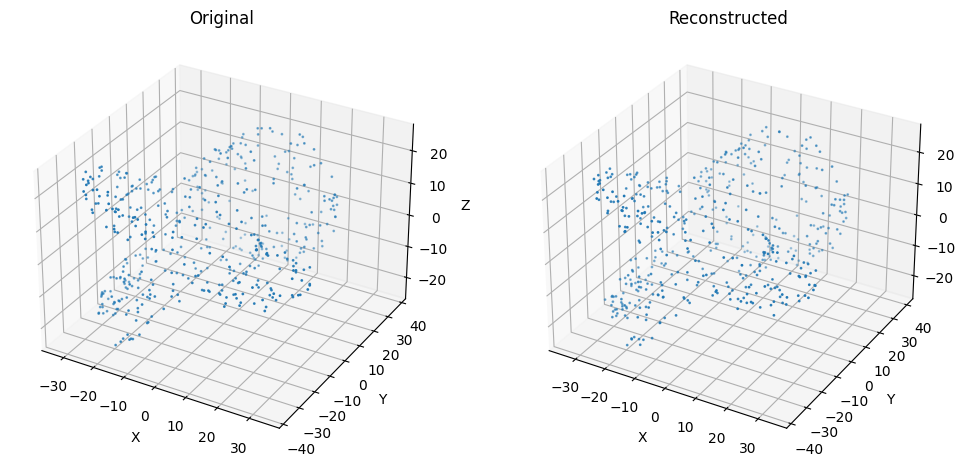

Training Point Cloud 9/11
Epoch 10, Loss: 97.14000701904297


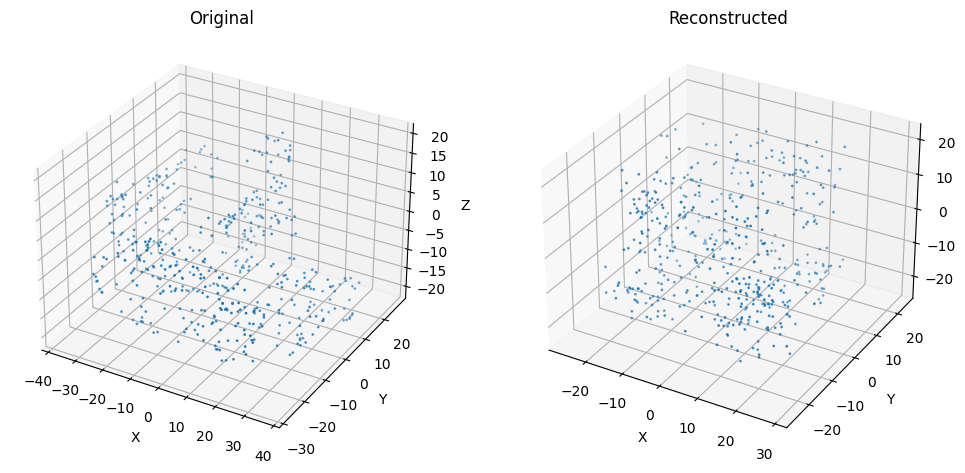

Epoch 20, Loss: 11.831465721130371


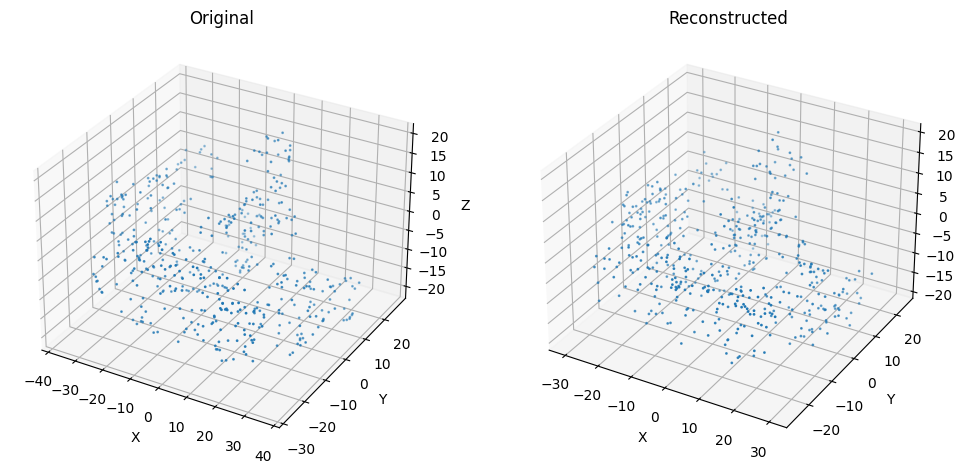

Epoch 30, Loss: 4.8726630210876465


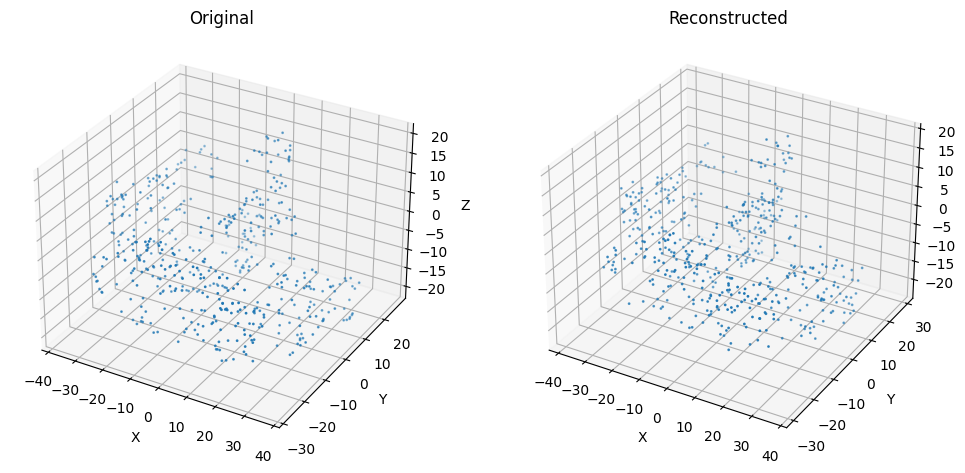

Epoch 40, Loss: 1.8796874284744263


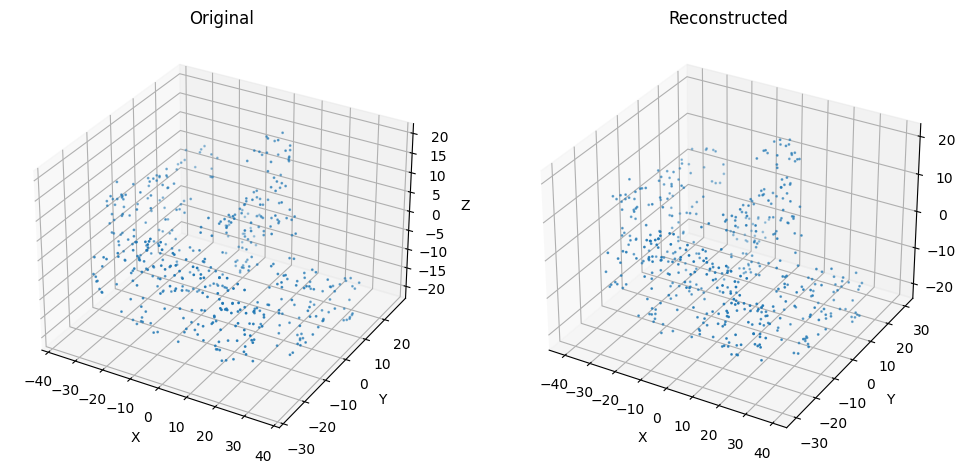

Epoch 50, Loss: 0.4833695888519287


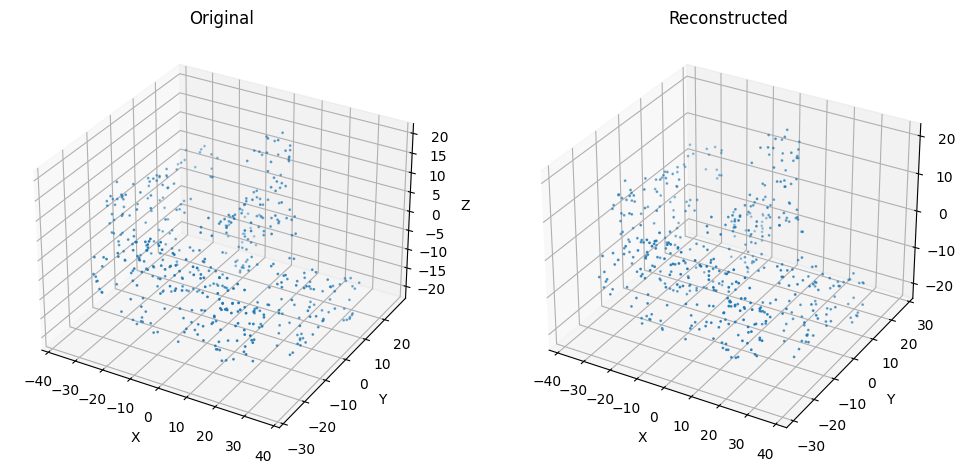

Training Point Cloud 10/11
Epoch 10, Loss: 0.09653997421264648


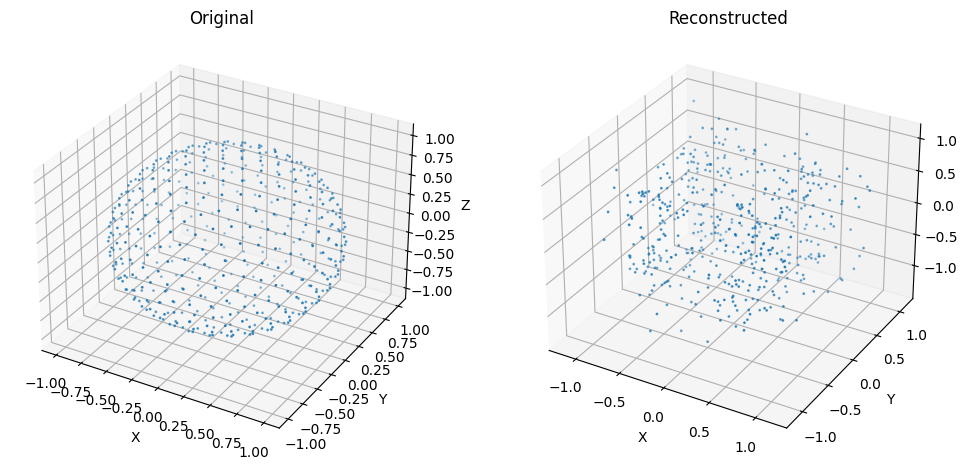

Epoch 20, Loss: 0.014727805741131306


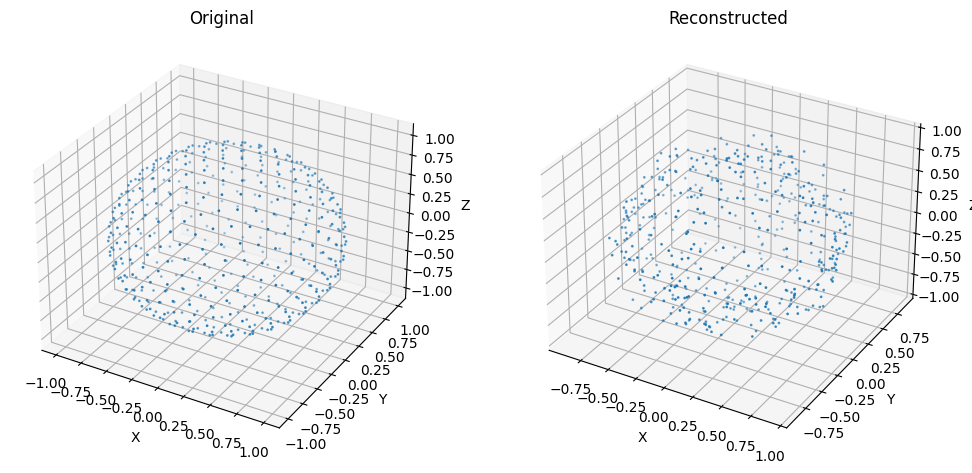

Epoch 30, Loss: 0.005958857014775276


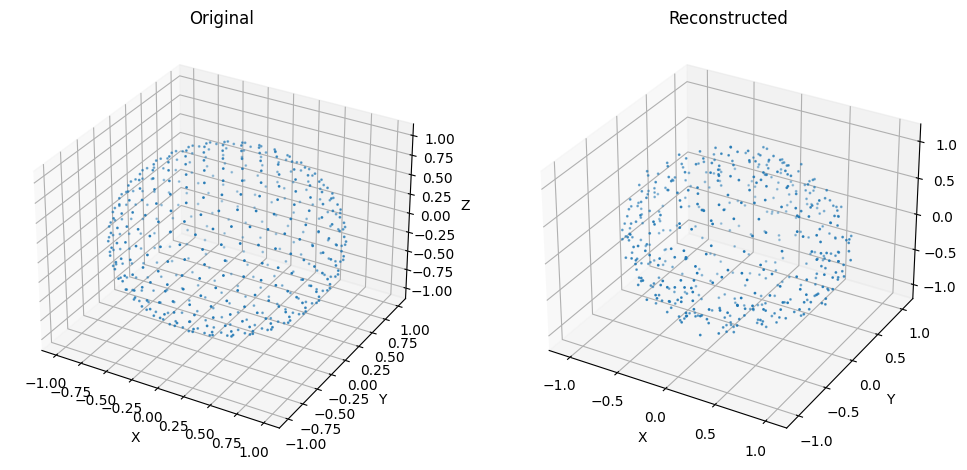

Epoch 40, Loss: 0.0020472726318985224


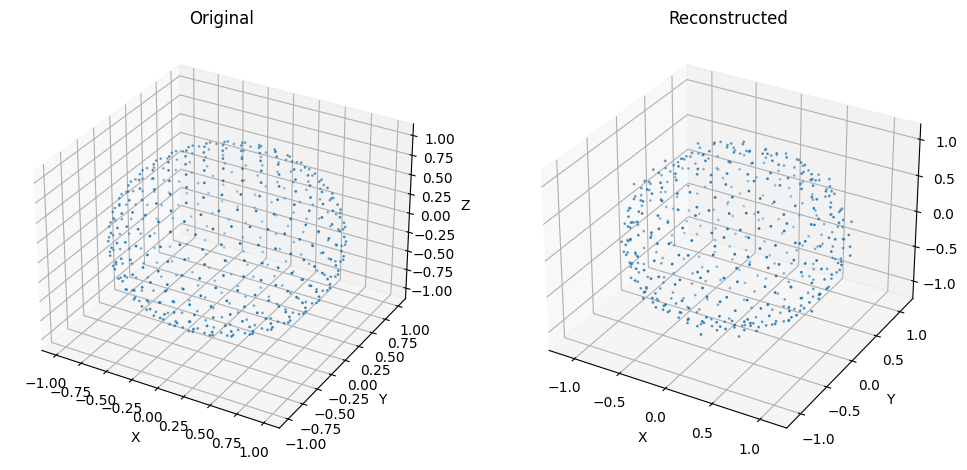

Epoch 50, Loss: 0.0006065926281735301


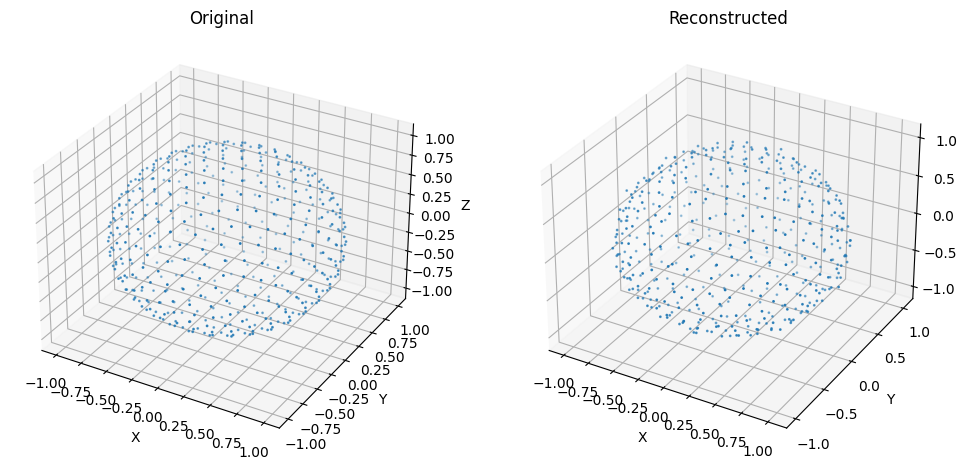

Training Point Cloud 11/11
Epoch 10, Loss: 1.1999437808990479


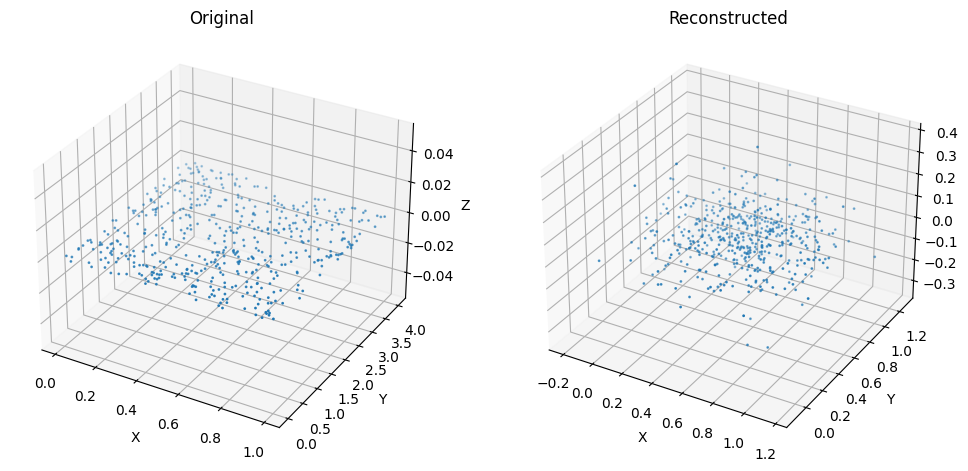

Epoch 20, Loss: 0.10003963857889175


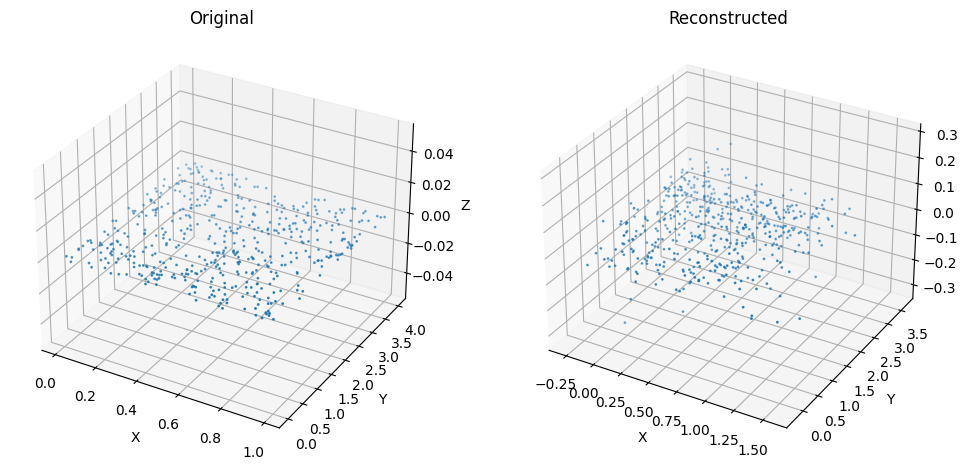

Epoch 30, Loss: 0.06900239735841751


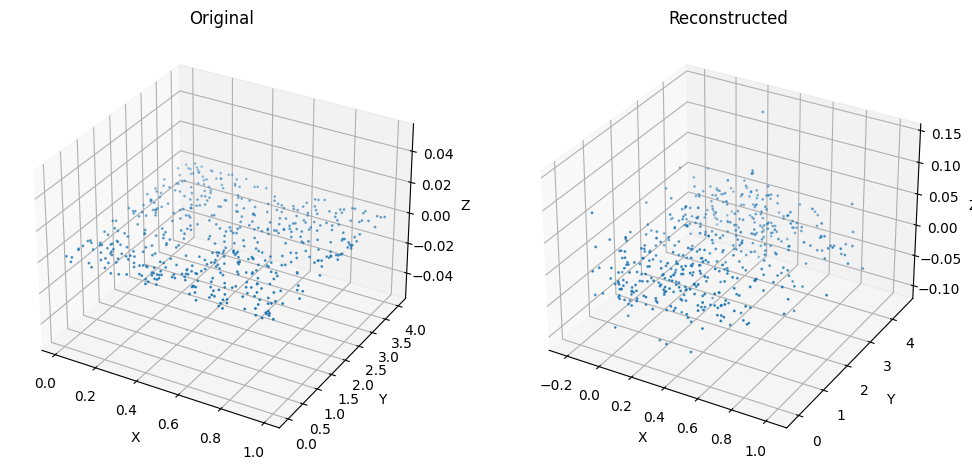

Epoch 40, Loss: 0.011976342648267746


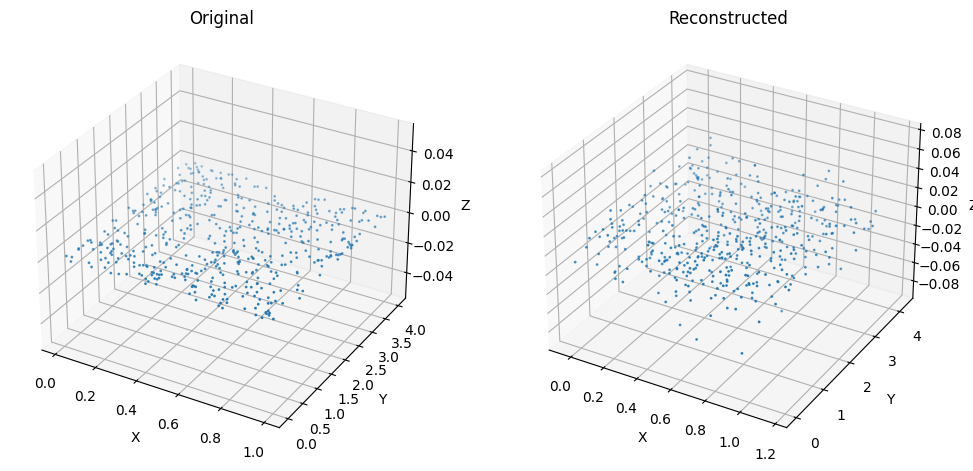

Epoch 50, Loss: 0.00572971161454916


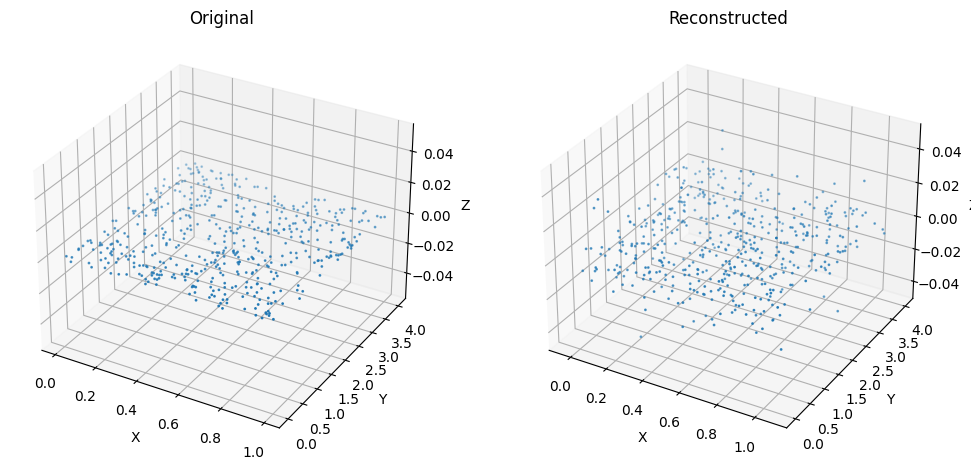

Testing model on a specific point cloud...
Latent vector shape of the test point cloud: (64,)
Latent vector representation of the test point cloud: [-0.00238712 -0.17985624  0.01333022  0.27540323  0.17076352  0.15056285
  0.21832767 -0.01754251  0.05125872 -0.06022426  0.15654159  0.08493096
  0.12885001 -0.10334481 -0.08201513  0.07809977  0.16927779  0.22695495
  0.16649944  0.11039172  0.29129797  0.28441623  0.19238922  0.05359272
  0.0988452  -0.10232338  0.25330594  0.08926793  0.06413543  0.10111633
 -0.12225261 -0.12223051  0.15920138 -0.13646644  0.18539616  0.15672591
  0.2923268   0.17598988  0.20089619 -0.13890228 -0.08086387  0.29086268
 -0.01336749  0.12941091 -0.12683257  0.15367264  0.1310365   0.20790443
  0.24418446  0.17673159 -0.00539518  0.00356077  0.29979795  0.12349023
  0.03168427  0.35198423 -0.19419692  0.22008577 -0.14298749  0.01379639
  0.3350495  -0.03128089  0.45607334 -0.02492031]
Training with latent size: 64
Training with latent size: 128
Training wi

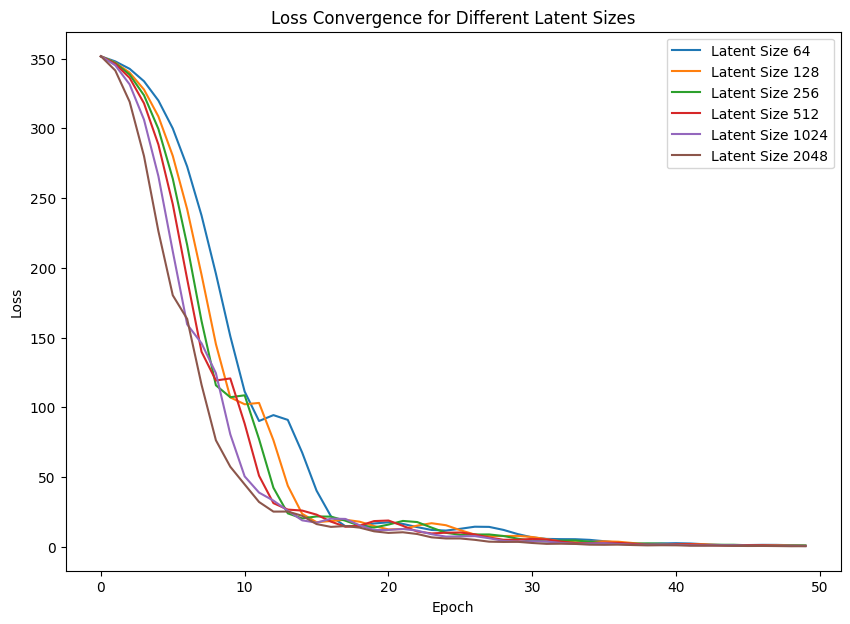

In [154]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from plyfile import PlyData
import os
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from torch.optim import Adam
from sklearn.decomposition import PCA

def main():

    # Initialize device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Initialize the PointCloudProcessor
    processor = PointCloudProcessor(config["folder_dir"])

    # Optionally display loaded point clouds
    if config["show_loaded_pointclouds"]:
        for i, point_cloud in enumerate(processor.point_clouds):
            processor.plot_point_cloud(point_cloud, title=f"Point Cloud {i + 1}")

    # Initialize and train the model on all point clouds
    print("Training on all point clouds...")
    trainer = Train()

    # model = PointNetAutoencoder(n).to(device)
    model_trained_on_all_pointclouds = trainer.train_and_visualize_on_multiple_point_clouds(processor.point_clouds, num_points=config["min_points"], latent_size=config["train_dim"], epochs=config["epochs"], lr=config["lr"], visualize_every_n_epochs=config["visualize_every_n_epochs"], condition=config["visualize_training"])

    # Test the model on a specific point cloud
    print("Testing model on a specific point cloud...")
    test_point_cloud = processor.load_point_cloud_from_ply(config["test_pointcloud_path"])
    test_point_cloud = processor.resample_point_cloud(test_point_cloud, config["min_points"])  # Resample the test point cloud to match train_dim

    latent_representation = trainer.encode_point_cloud(model_trained_on_all_pointclouds, test_point_cloud.to(device))
    print("Latent vector shape of the test point cloud:", latent_representation.shape)
    print("Latent vector representation of the test point cloud:", latent_representation)

    latent_sizes = config["test_dims"]
    point_cloud_index = 0  # Example point cloud index
    epochs = 100

    trainer.plot_loss_convergence_for_latent_sizes(latent_sizes, config["min_points"], processor.point_clouds, point_cloud_index, config["epochs"])

if __name__ == "__main__":
    main()
